##### <p style="text-align: center;"> ![alt text](utilities/cilss.png)</p>
# <p style="text-align: center;">AGHRYMET RCC-WAS</p>
#### &copy; Mandela HOUNGNIBO 2024 (Find more [here](https://github.com/hmandela))

## Library

In [72]:
from wass2s import *
import xcast as xc
import importlib
from pathlib import Path
import warnings
import gc
warnings.filterwarnings("ignore")

#### Set forecast working directory

In [73]:
# Set forecast working directory
dir_s2s = "./JAS_2025"

In [74]:
dir_s2s = Path(dir_s2s)
os.makedirs(dir_s2s, exist_ok=True)
### Save consolidated results
hdcst_consolidated = {}
fcst_consolidated = {}
scores_consolidated = {}
### Save score
dir_save_score = f"{dir_s2s}/scores"
os.makedirs(dir_save_score, exist_ok=True)
### Save forecasts
dir_to_forecast = f"{dir_s2s}/forecasts"
os.makedirs(dir_to_forecast, exist_ok=True)

#### Set Climatological Years

In [75]:
# Set Climatological Years
clim_year_start = 1994 #1991
clim_year_end = 2016 #2020
dist_method="lognormal" # "gamma", "t", "lognormal", "norm", "nonparam", "weibull_min"

## Download Observation and Process 


#### Load Downloader 

In [76]:
# Load WAS_S2S downloader class
downloader = WAS_Download()

In [77]:
# Filter observation names to identify precipitation-related models
variables_obs = [key for key in downloader.AgroObsName().keys() if "PRCP" in key]

# Specify the directory to save downloaded model data
dir_to_save_Obs = f"{dir_s2s}/Observation"

# choose sequence corresponding to seasonal forecast targets (JAS season in this case)
season_obs = ["07", "08", "09"]  # July-August-September forecast period

# Define the observation period (years 1993 to 2016)
year_start = 1991
year_end = 2024

# Set the bounding box for the area of interest (latitude and longitude bounds)
extent_obs = [15.2, -5.7, 9.25, 2.42]  # [Northern, Western, Southern and Eastern] 

# Specify whether to overwrite existing files when downloading data
force_download = False

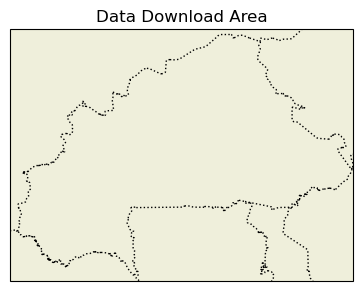

In [78]:
plot_map([extent_obs[1],extent_obs[3],extent_obs[2],extent_obs[0]], title="Data Download Area", fig_size=(4,3))

In [79]:
downloader.WAS_Download_AgroIndicators(
    dir_to_save_Obs,
    variables_obs,
    year_start,
    year_end,
    extent_obs,
    season_obs,
    force_download
)

JAS_2025/Observation/Obs_PRCP_1991_2024_JulAugSep.nc already exists. Skipping download.


In [80]:
#### Process predictant
rainfall = prepare_predictand(dir_to_save_Obs, variables_obs, year_start, year_end, season_obs, ds=False, daily=False)
season_str = "".join([calendar.month_abbr[int(month)] for month in season_obs])

#### Process Obs in combining with Seasonal cumulative Ground-Observation

In [81]:
# ## Path to the CPT file
# cpt_input_file_path = "./Observation/MAM_1991-2023_.txt"

In [82]:
# ## Read CSV
# df = pd.read_csv(cpt_input_file_path, na_values=-999.0, sep='\t')
# df_filtered = df[(df['STATION'] == 'LAT') | (df['STATION'] == 'LON') | 
#                  (pd.to_numeric(df['STATION'], errors='coerce').between(year_start, year_end))]

In [83]:
# da = prepare_predictand(dir_to_save_Obs, variables_obs, year_start, year_end, season_obs,  ds=False).sel(T=slice(str(year_start),str(year_end)))

In [84]:
# ## Instantiate WAS_Merging class
# data_merger = WAS_Merging(df_filtered, da, date_month_day= '04-01')
# rainfall__, _ = data_merger.simple_bias_adjustment(do_cross_validation=False)

In [85]:
# data_merger.plot_merging_comparaison(df_filtered, da, rainfall__)

# 1st - Approach: Choice of Best Dynamical models and weighted Average

In [86]:
# Filter model names to identify precipitation-related models
center_variable = [key for key in downloader.ModelsName().keys() if "PRCP" in key]
center_variable.remove('UKMO_603.PRCP')
# Specify the directory to save downloaded model data
dir_to_save_model = f"{dir_s2s}/model_data"

# Define the month for model initialization (June)
month_of_initialization = "03"

# Define lead times corresponding to seasonal forecast targets (JAS season in this case)
lead_time = ["04", "05", "06"]  # July-August-September forecast period

# Define the hindcast period for model data (years 1993 to 2016)
year_start_model = 1993
year_end_model = 2016

# Set the bounding box for the area of interest (latitude and longitude bounds)
extent = [15.2, -5.7, 9.25, 2.42] #[21, -18, 7, 25]  [11, -9, 4, -2] [Northern, Western, Southern and Eastern] 

# Define if you want to download forecast or hindcast
forecast = None

# Define if you want all members of ensemble or doing an ensemble mean
ensemble_mean = "mean"

# Specify whether to overwrite existing files when downloading data
force_download = False

In [87]:
hindcast_files = downloader.WAS_Download_Models(
    dir_to_save_model,
    center_variable,
    month_of_initialization,
    lead_time,
    year_start_model,
    year_end_model,
    extent, 
    forecast,
    ensemble_mean,
    force_download)

2025-04-09 19:11:07,619 INFO [2024-09-26T00:00:00] Watch our [Forum](https://forum.ecmwf.int/) for Announcements, news and other discussed topics.
2025-04-09 19:11:07,620 WARNING [2024-06-16T00:00:00] CDS API syntax is changed and some keys or parameter names may have also changed. To avoid requests failing, please use the "Show API request code" tool on the dataset Download Form to check you are using the correct syntax for your API request.
2025-04-09 19:11:08,160 INFO Request ID is c04adfc0-f8ba-4345-b78f-48ee5b10e56e
2025-04-09 19:11:08,436 INFO status has been updated to accepted


KeyboardInterrupt: 

In [ ]:
forecast = 2025

In [ ]:
forecast_files = downloader.WAS_Download_Models(
    dir_to_save_model,
    center_variable,
    month_of_initialization,
    lead_time,
    year_start_model,
    year_end_model,
    extent, 
    forecast,
    ensemble_mean,
    force_download)

In [ ]:
was_verify = WAS_Verification(dist_method=dist_method)

#### Validation of GCM

In [20]:
score = ["Pearson", "MAE", "GROC"]

Pearson Correlation


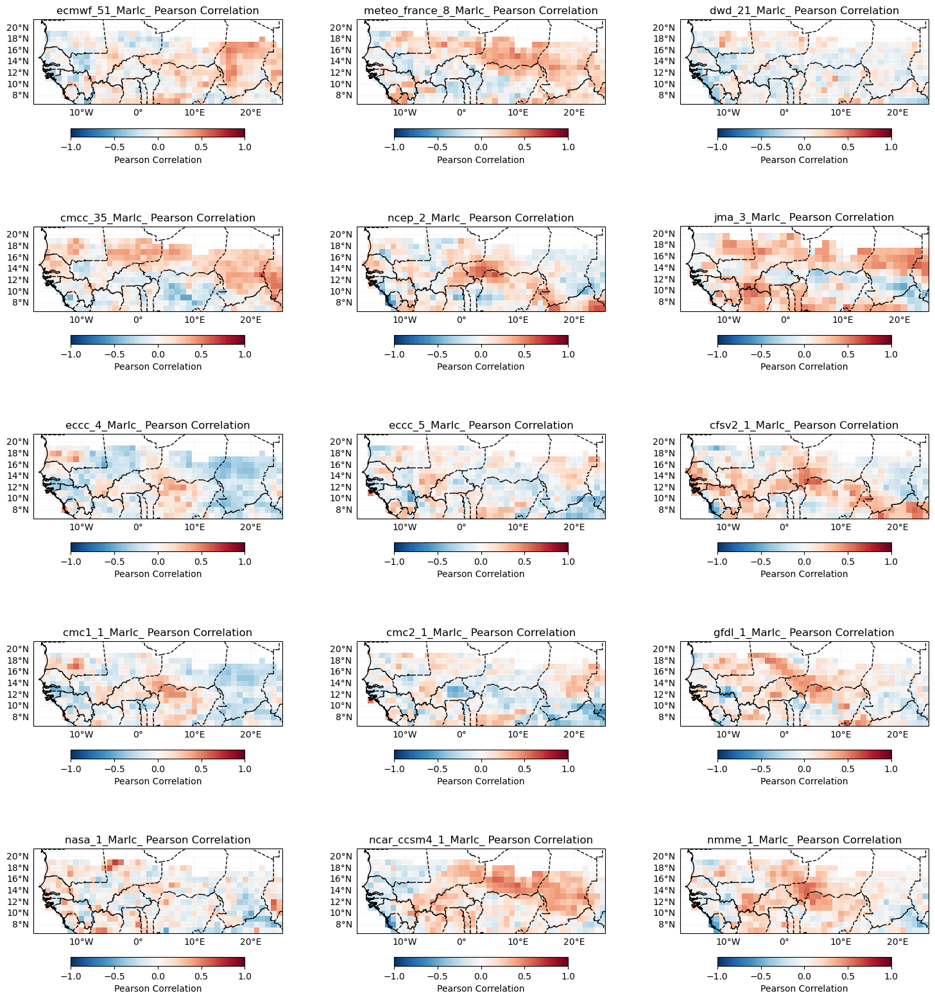

Mean Absolute Error


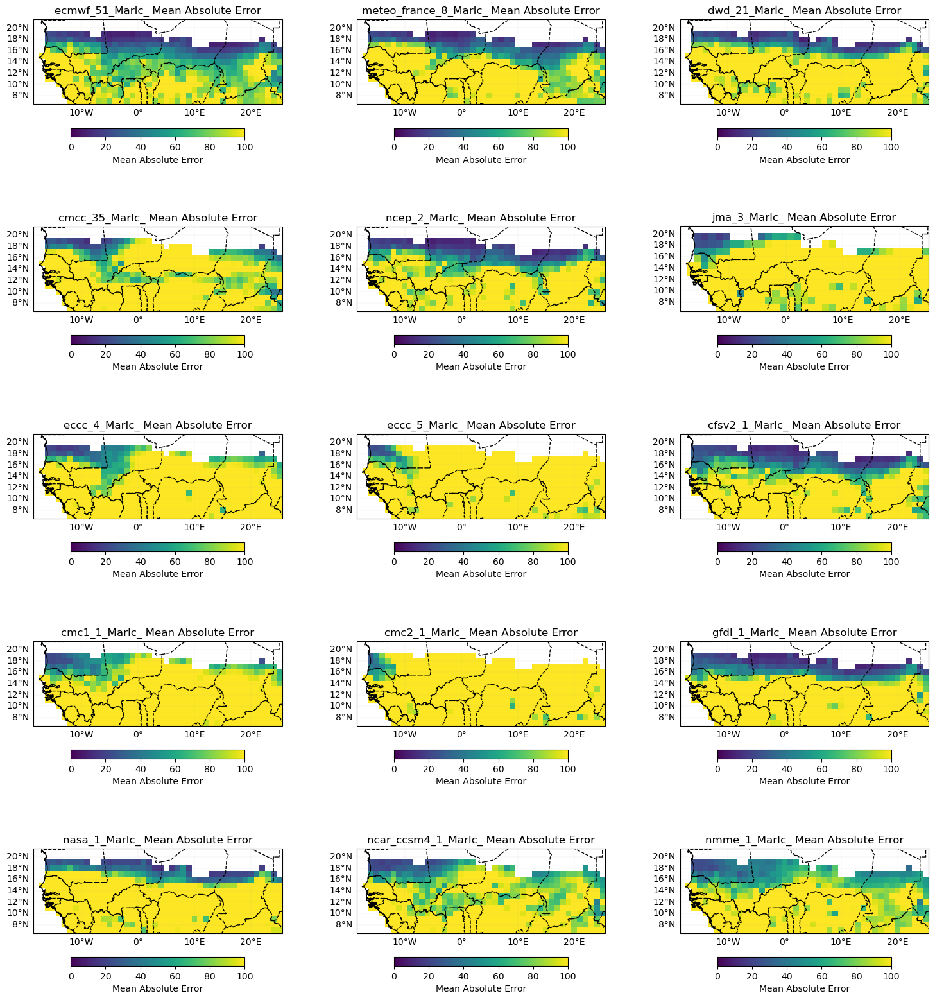

Generalized Discrimination Score


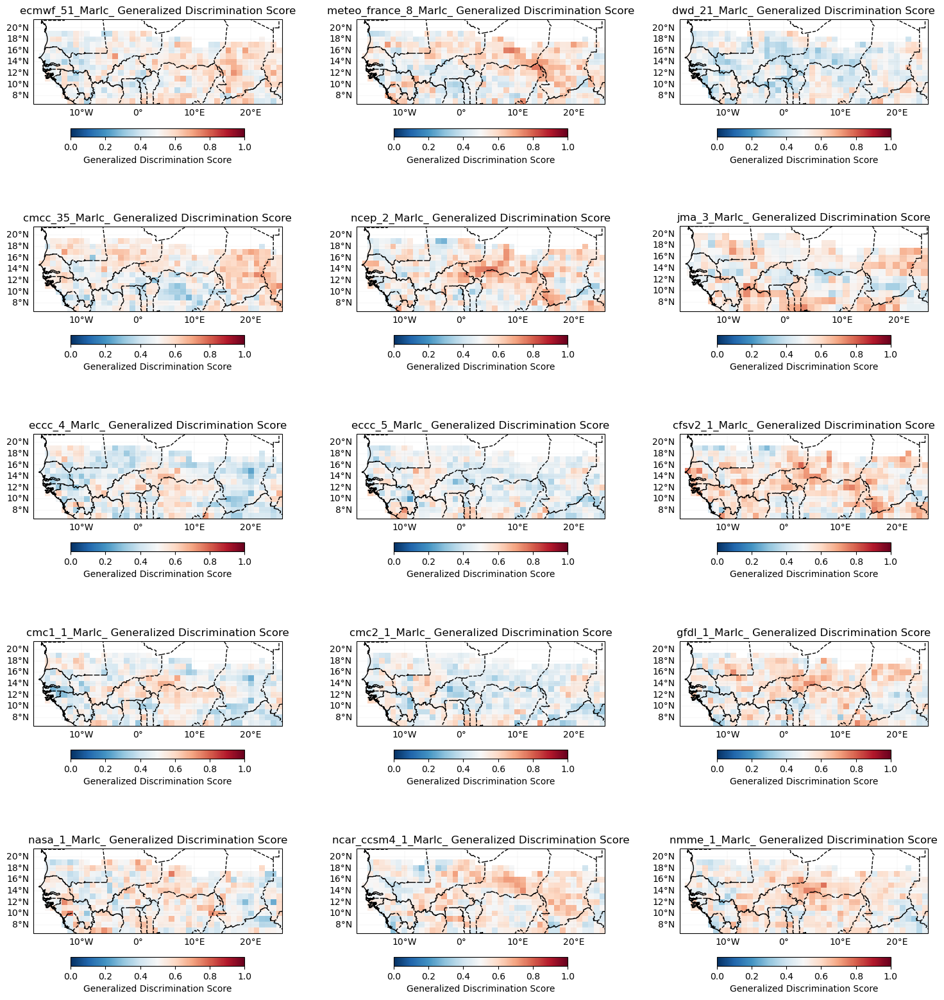

In [21]:
score = score.append('GROC') if 'GROC' not in score else score
os.makedirs(dir_save_score, exist_ok=True)
scores = {}
for i in score:
    scores[i] = was_verify.gcm_validation_compute(hindcast_files, rainfall, i, month_of_initialization, clim_year_start, clim_year_end, dir_save_score, lead_time = None, ensemble_mean=None, gridded=True)
    print(was_verify.scores[i][0])
    was_verify.plot_models_score(scores[i], i, dir_save_score)

## Choice of best GCM models

In [22]:
best_models = get_best_models(center_variable, scores, metric='MAE', threshold=100, top_n=7, gcm=True)
best_models

['ECMWF_51.PRCP',
 'NCAR_CCSM4_1.PRCP',
 'NMME_1.PRCP',
 'NCEP_2.PRCP',
 'CFSV2_1.PRCP',
 'METEOFRANCE_8.PRCP',
 'CMCC_35.PRCP']

## MME for best GCM models

In [26]:
# Set parameters for extreme learning
elm_kwargs = {
                'regularization': 10,
                'hidden_layer_size': 7,
                'activation': 'lin',  # 'sigm', 'tanh', 'lin', 'relu',],
                'preprocessing': 'none',  # 'minmax', 'std', 'none' ],
                'n_estimators': 10,
                            }
model = WAS_mme_ELM(elm_kwargs=elm_kwargs, dist_method=dist_method)

#### Cross-validation

In [28]:
all_model_hdcst, all_model_fcst, obs, best_score = process_datasets_for_mme(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))), gcm=True, ELM_ELR=True, dir_to_save_model=dir_to_save_model, best_models=best_models, scores=scores, year_start=year_start_model, year_end=year_end_model, model=True, month_of_initialization=month_of_initialization, lead_time=lead_time, year_forecast=forecast)

In [29]:
was_mme_gcm = WAS_Cross_Validator(n_splits=len(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))).get_index("T")), nb_omit=2)

In [33]:
hindcast_det_gcm, hindcast_prob_gcm, = was_mme_gcm.cross_validate(model, obs, all_model_hdcst, clim_year_start, clim_year_end)
hdcst_consolidated['first.approach'] = hindcast_det_gcm

Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [09:10<00:00, 22.94s/it]


#### Verification

In [31]:
score = ['Pearson','MAE']
model_name = "MME_best_GCM_Models"

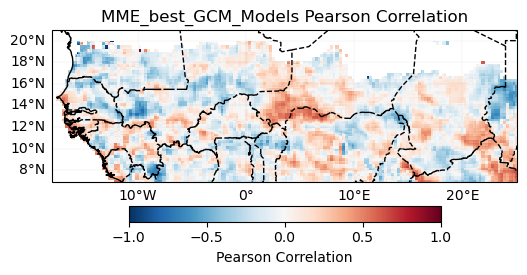

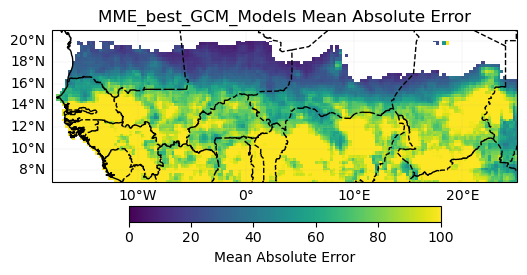

In [32]:
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
        hindcast_det_gcm
    )
    scores_consolidated[i] = {'first.approach': r}
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

##### Probabilistic

In [33]:
score = ['GROC']

Generalized Discrimination Score


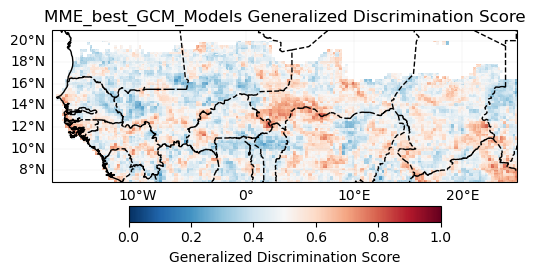

In [34]:
score = score.append('GROC') if 'GROC' not in score else score
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
        hindcast_prob_gcm,
        clim_year_start,
        clim_year_end)
    scores_consolidated[i] = {'first.approach': r}
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

#### Forecast 

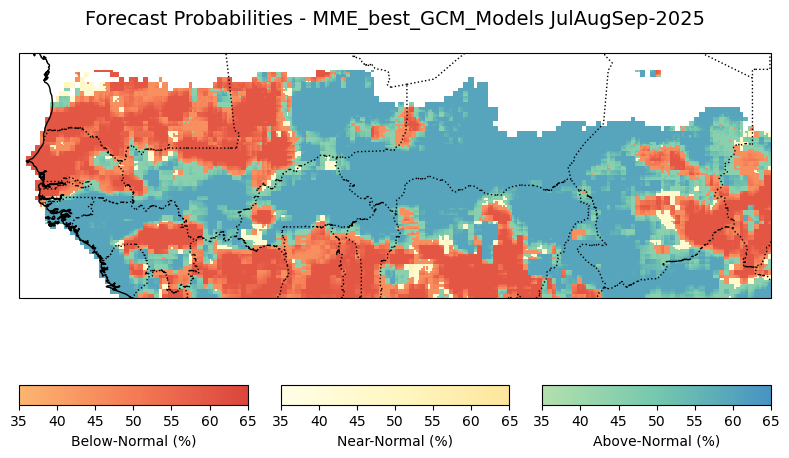

8476

In [35]:
forecast_det_gcm, forecast_prob_gcm= model.forecast(obs, clim_year_start, clim_year_end, all_model_hdcst, hindcast_det_gcm, all_model_fcst)
fcst_consolidated['first.approach'] = forecast_det_gcm
plot_prob_forecasts(dir_to_forecast, forecast_prob_gcm.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)
gc.collect()

# 2nd - Approach: Statistico-Dynamical

In [36]:
# Filter model names to identify precipitation-related models
center_variable = [key for key in downloader.ModelsName().keys() if "SST" in key]
center_variable.remove('NASA_1.SST')
center_variable.remove('UKMO_603.SST')
# center_variable.remove('DWD_21.SST')
# center_variable.remove('CMCC_35.SST')
# center_variable.remove('METEOFRANCE_8.SST')

# Specify the directory to save downloaded model data
dir_to_save_model = f"{dir_s2s}/model_data"

# Define the month for model initialization (June)
month_of_initialization = "03"

# Define lead times corresponding to seasonal forecast targets (JAS season in this case)
lead_time = ["04", "05", "06"]  # July-August-September forecast period

# Define the hindcast period for model data (years 1993 to 2016)
year_start_model = 1993
year_end_model = 2016

# Set the bounding box for the area of interest (latitude and longitude bounds)
extent = [60, -180, -60, 180]  # [Northern, Western, Southern and Eastern] 

# Define if you want to download forecast or hindcast
forecast = None

# Define if you want all members of ensemble or doing an ensemble mean
ensemble_mean = "mean"

# Specify whether to overwrite existing files when downloading data
force_download = False

In [37]:
hindcast_files = downloader.WAS_Download_Models(
    dir_to_save_model,
    center_variable,
    month_of_initialization,
    lead_time,
    year_start_model,
    year_end_model,
    extent, 
    forecast,
    ensemble_mean,
    force_download)

JAS_2025/model_data/hindcast_ecmwf51_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_meteofrance8_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_dwd21_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_cmcc35_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_ncep2_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_jma3_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_eccc4_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_eccc5_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_cfsv21_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_cmc11_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/hindcast_c

In [38]:
forecast = 2025

In [39]:
forecast_files = downloader.WAS_Download_Models(
    dir_to_save_model,
    center_variable,
    month_of_initialization,
    lead_time,
    year_start_model,
    year_end_model,
    extent, 
    forecast,
    ensemble_mean,
    force_download)

JAS_2025/model_data/forecast_ecmwf51_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_meteofrance8_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_dwd21_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_cmcc35_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_ncep2_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_jma3_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_eccc4_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_eccc5_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_cfsv21_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_cmc11_SST_MarIc_JulAugSep_04.nc already exists. Skipping download.
JAS_2025/model_data/forecast_c

### Initialize the WAS_CCA class (default)

In [40]:
n_modes = 5
# define zone as dict : {'zone_name_key': ('Explicit_Zone_name', lon_min, lon_max, lat_min, lat_max)} 
defined_zone = {'A': ('A', -150, 150, -45, 45)}  

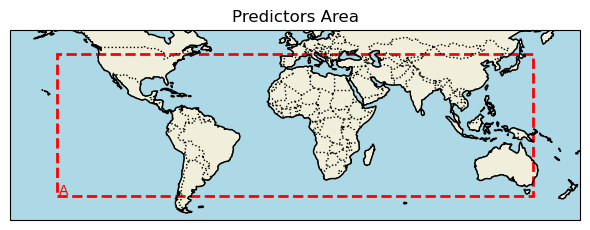

In [41]:
plot_map([extent[1],extent[3],extent[2],extent[0]], sst_indices = defined_zone, title="Predictors Area",fig_size=(6,4))

##### Modes of CCA for each model

In [42]:
was_cca = WAS_CCA(n_modes=n_modes, n_pca_modes=10, dist_method=dist_method)
was_cv = WAS_Cross_Validator(n_splits=len(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))).get_index("T")), nb_omit=2)

CCA Modes for model ECMWF_51.SST


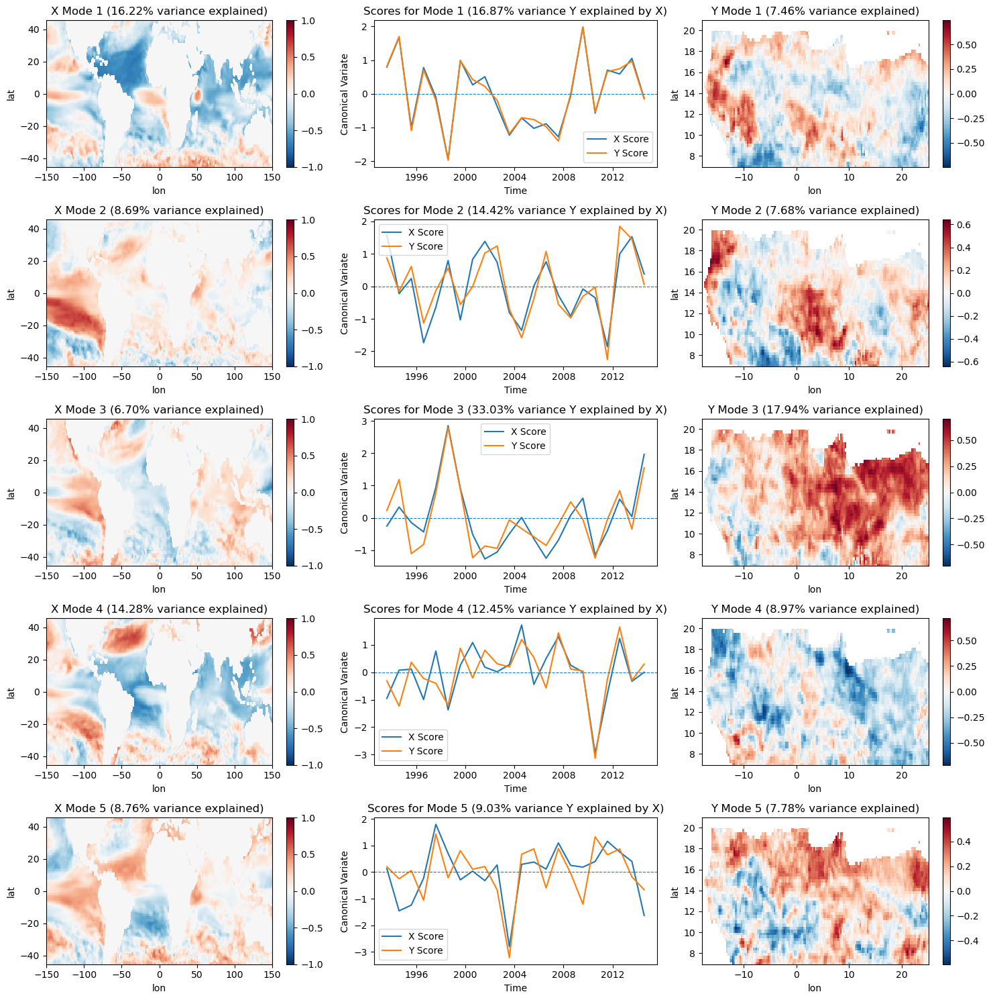

CCA Modes for model METEOFRANCE_8.SST


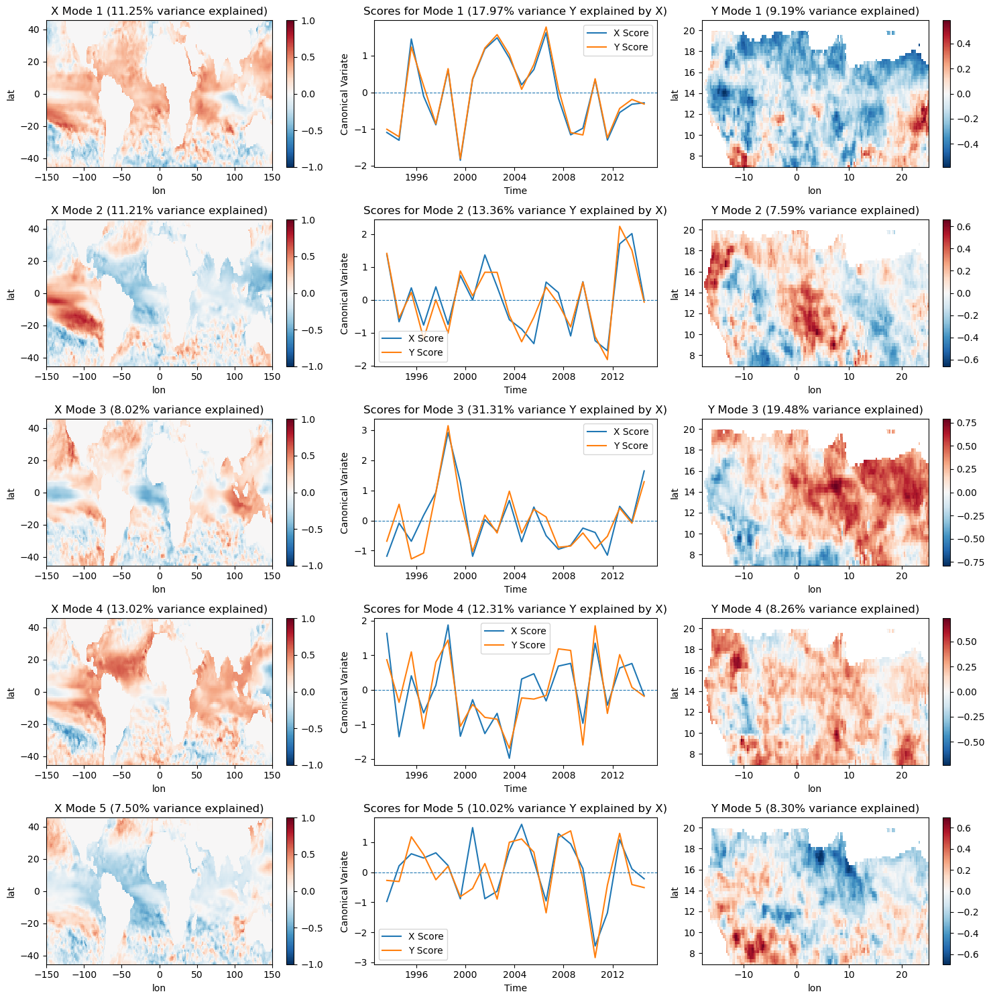

CCA Modes for model DWD_21.SST


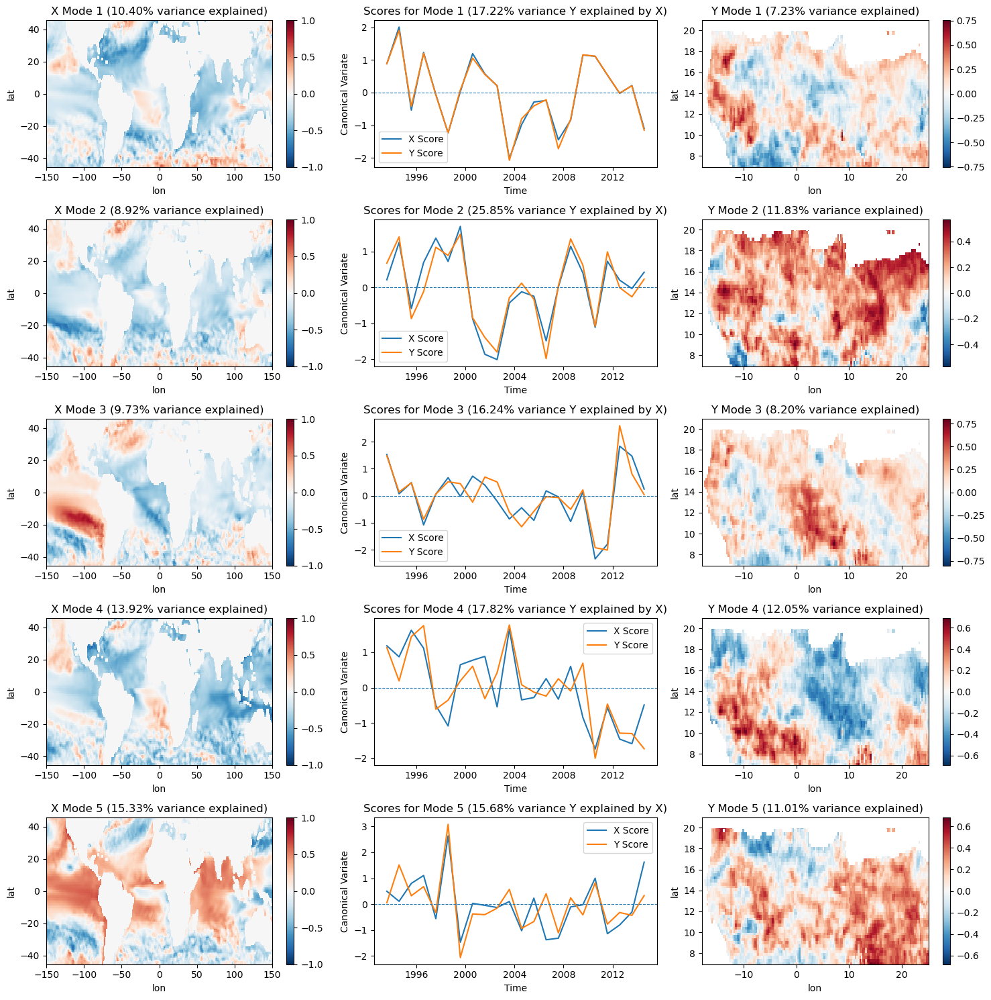

CCA Modes for model CMCC_35.SST


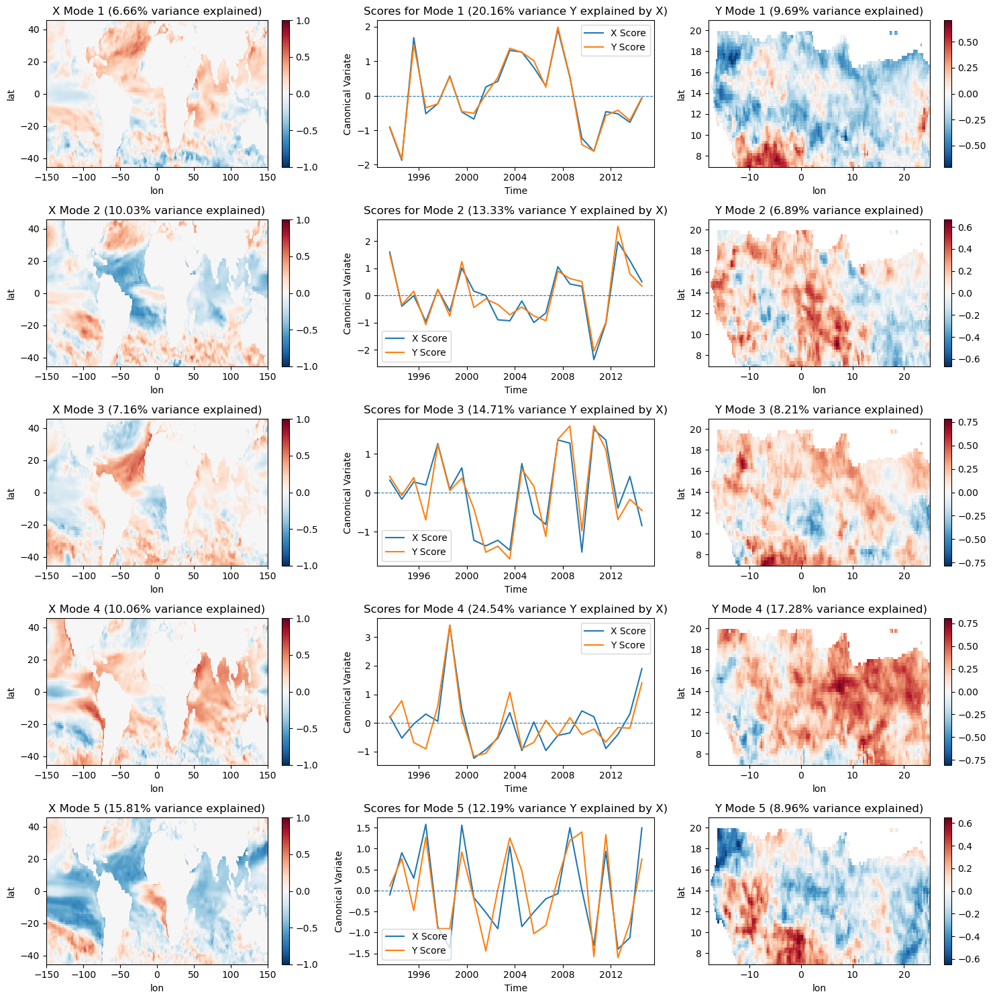

CCA Modes for model NCEP_2.SST


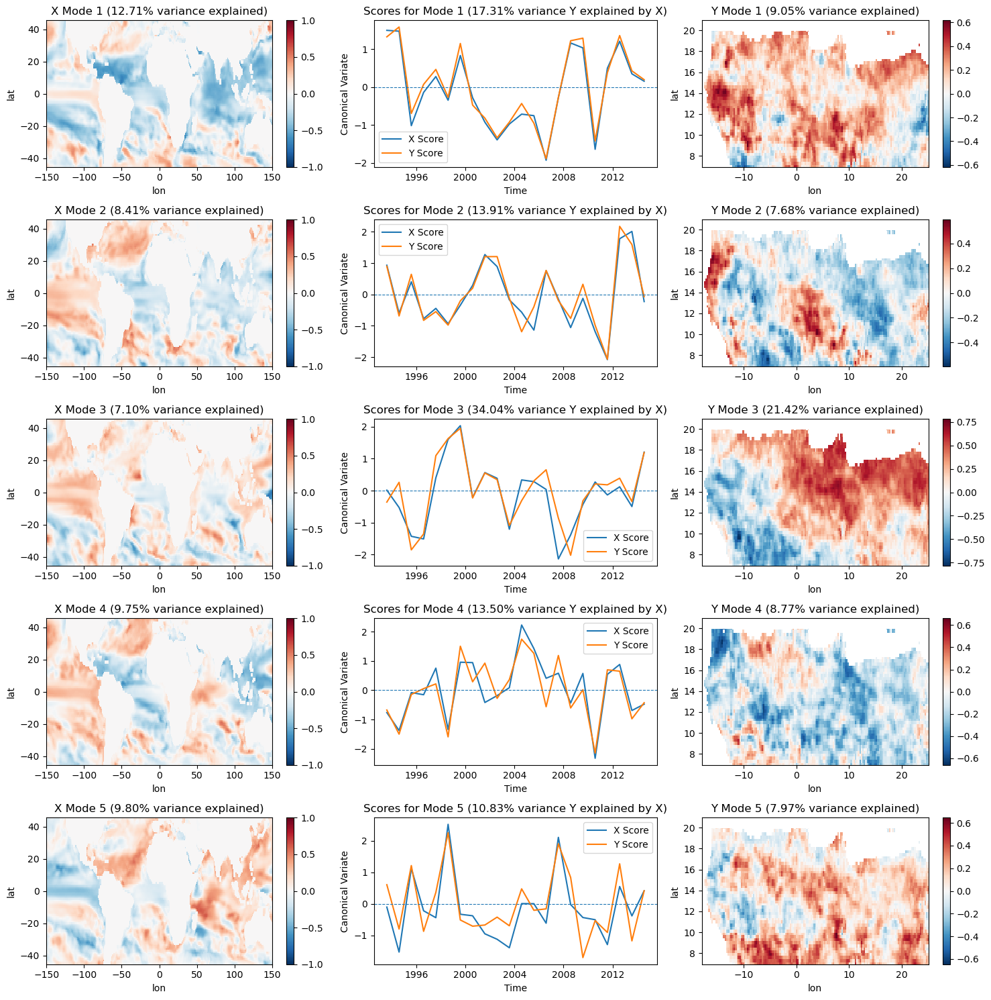

CCA Modes for model JMA_3.SST


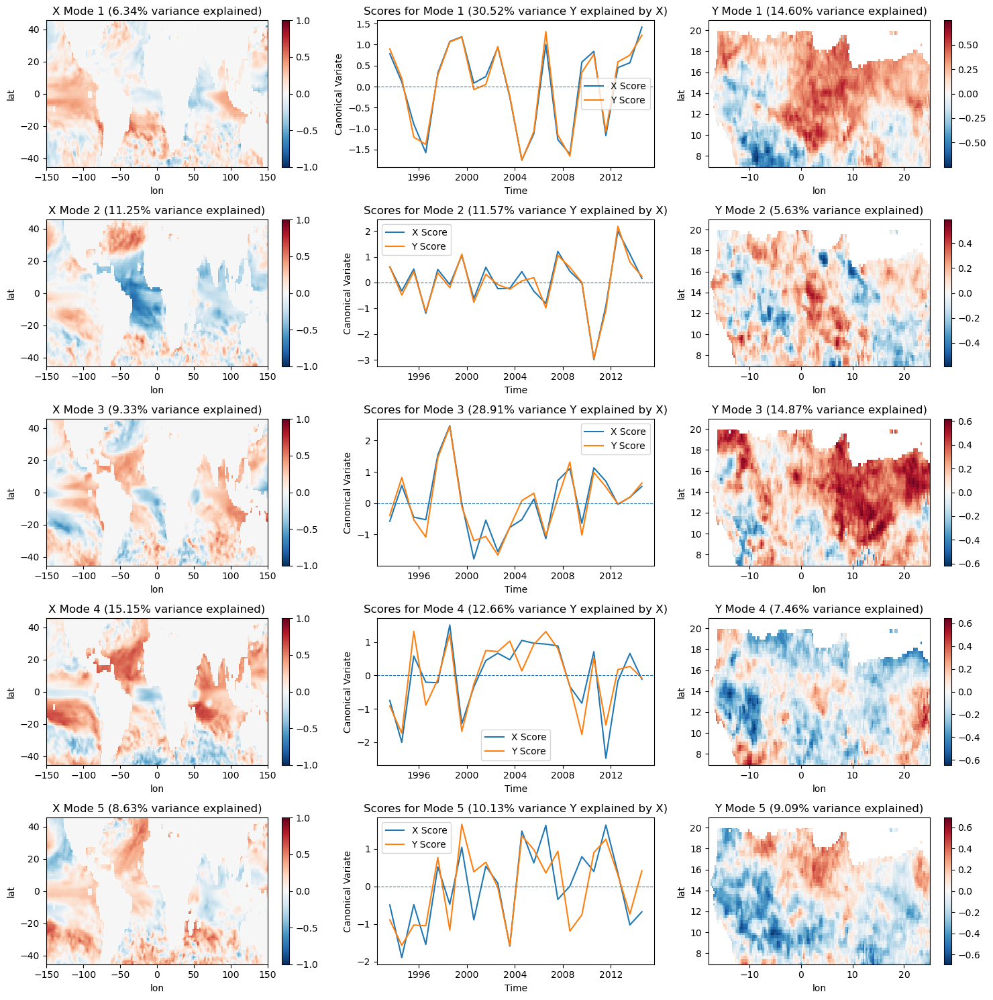

CCA Modes for model ECCC_4.SST


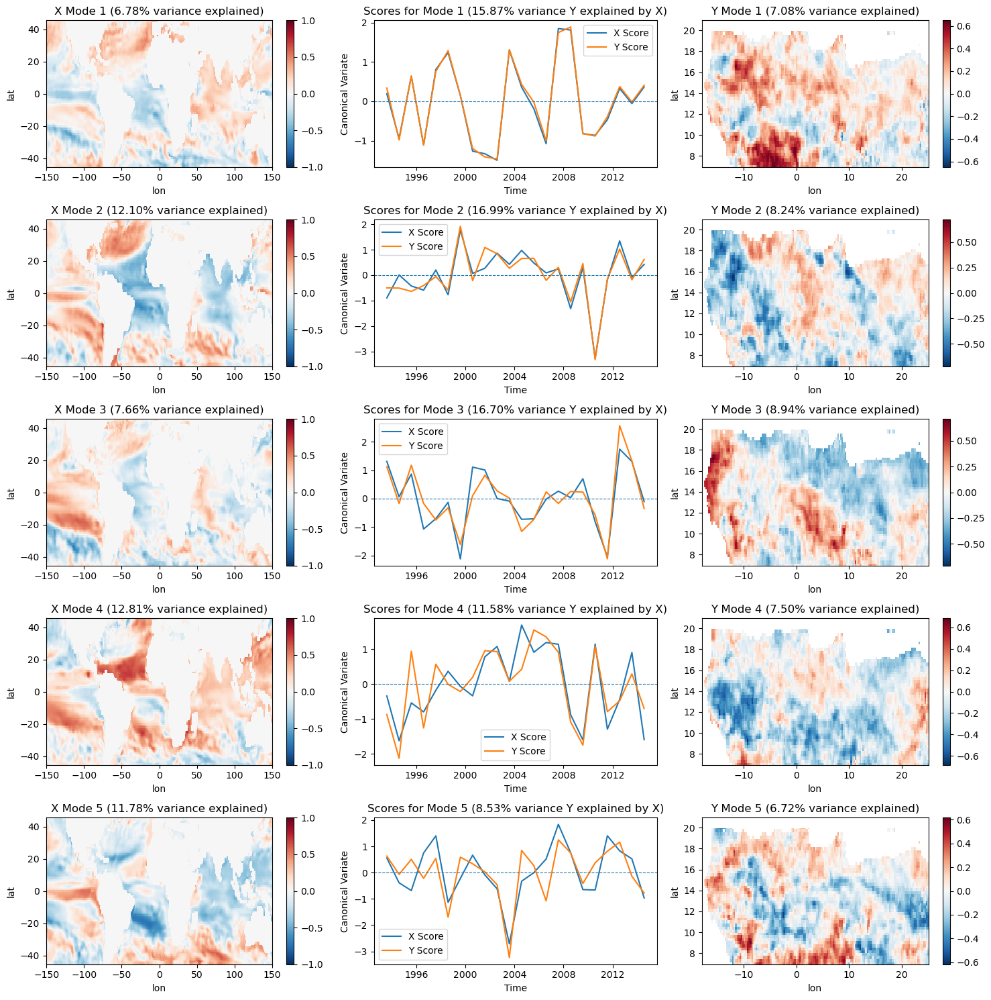

CCA Modes for model ECCC_5.SST


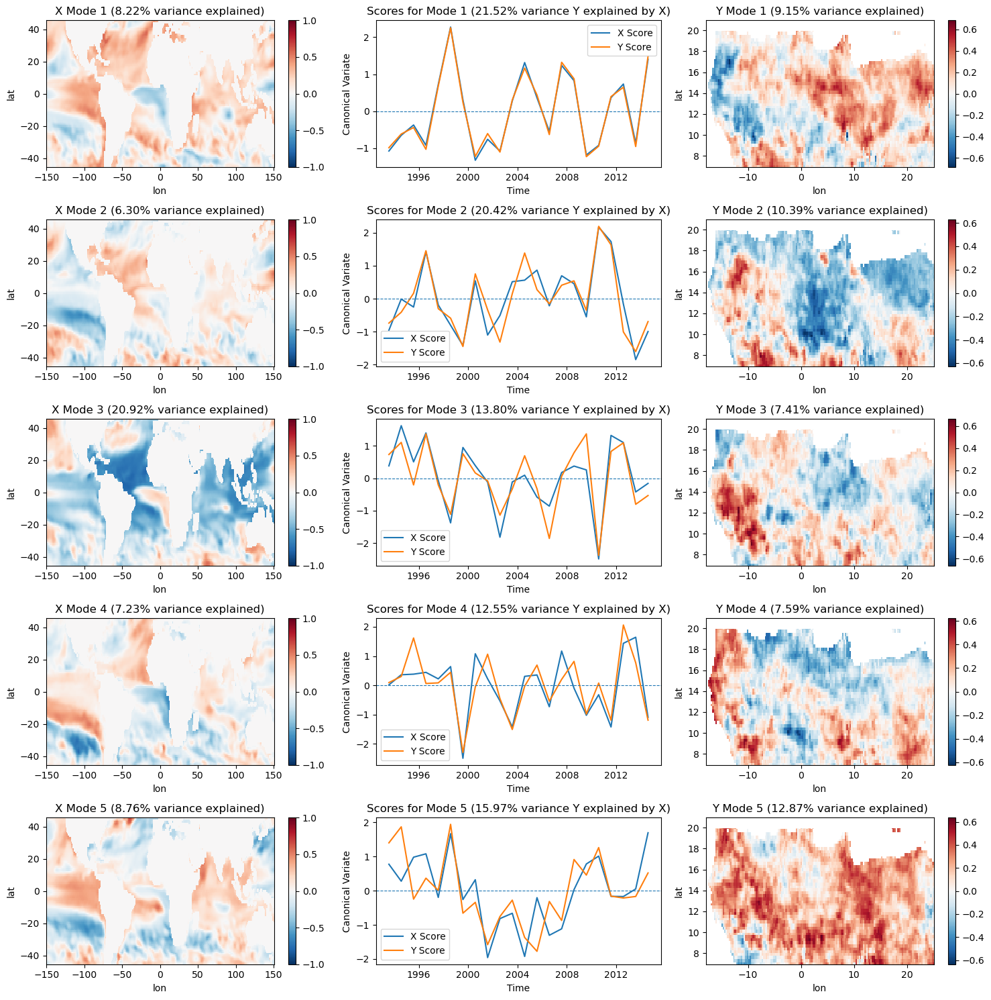

CCA Modes for model CFSV2_1.SST


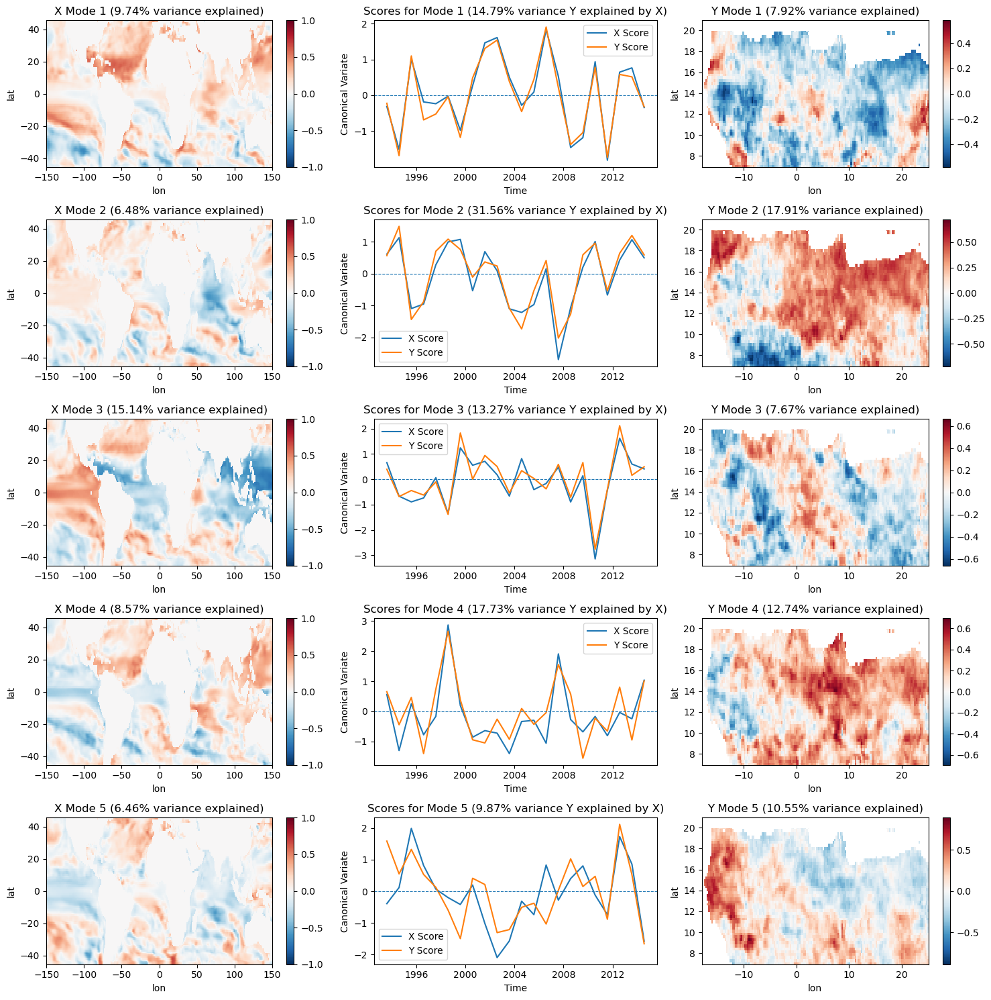

CCA Modes for model CMC1_1.SST


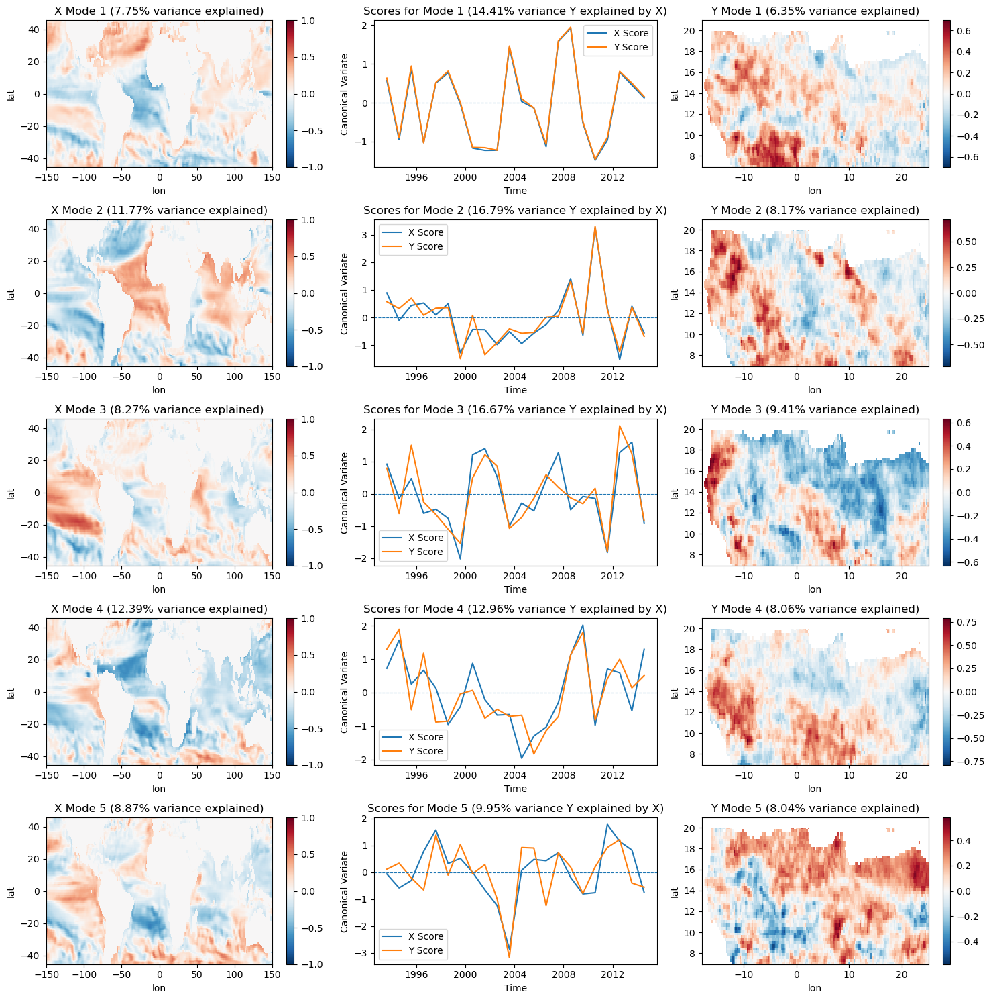

CCA Modes for model CMC2_1.SST


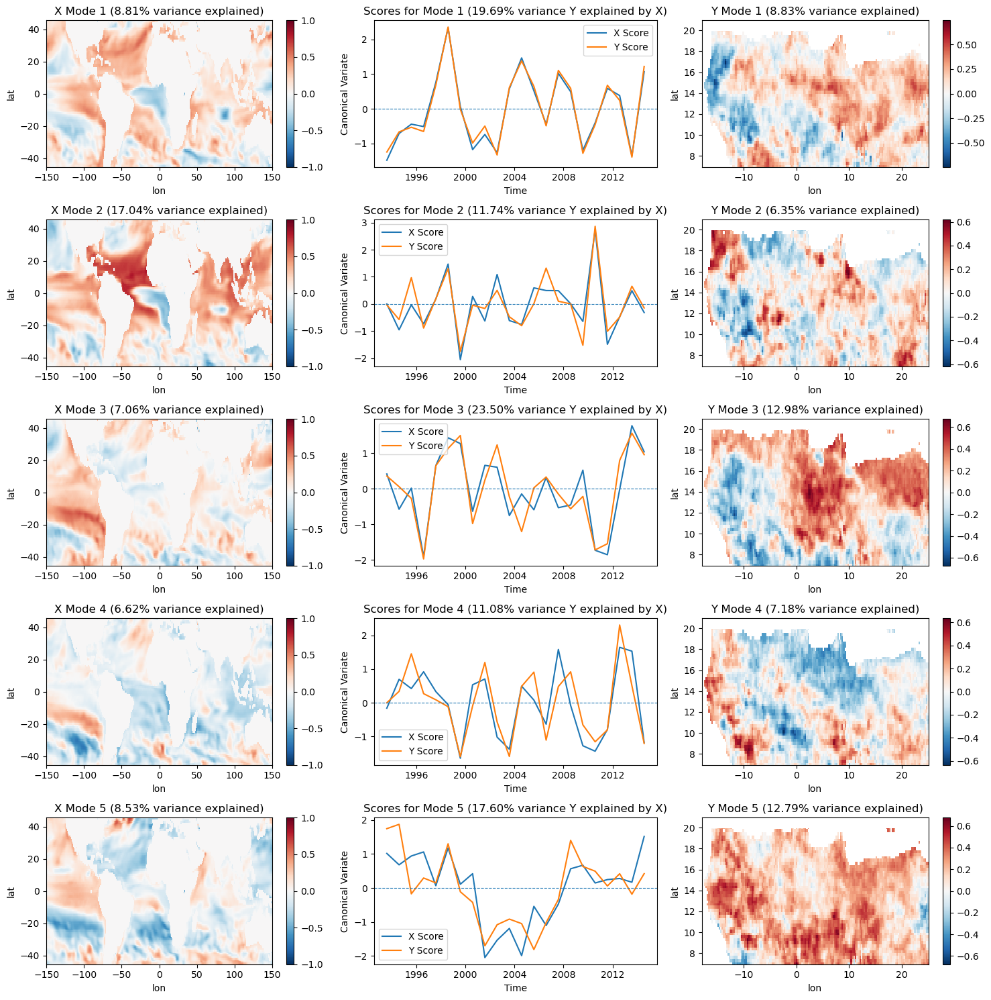

CCA Modes for model GFDL_1.SST


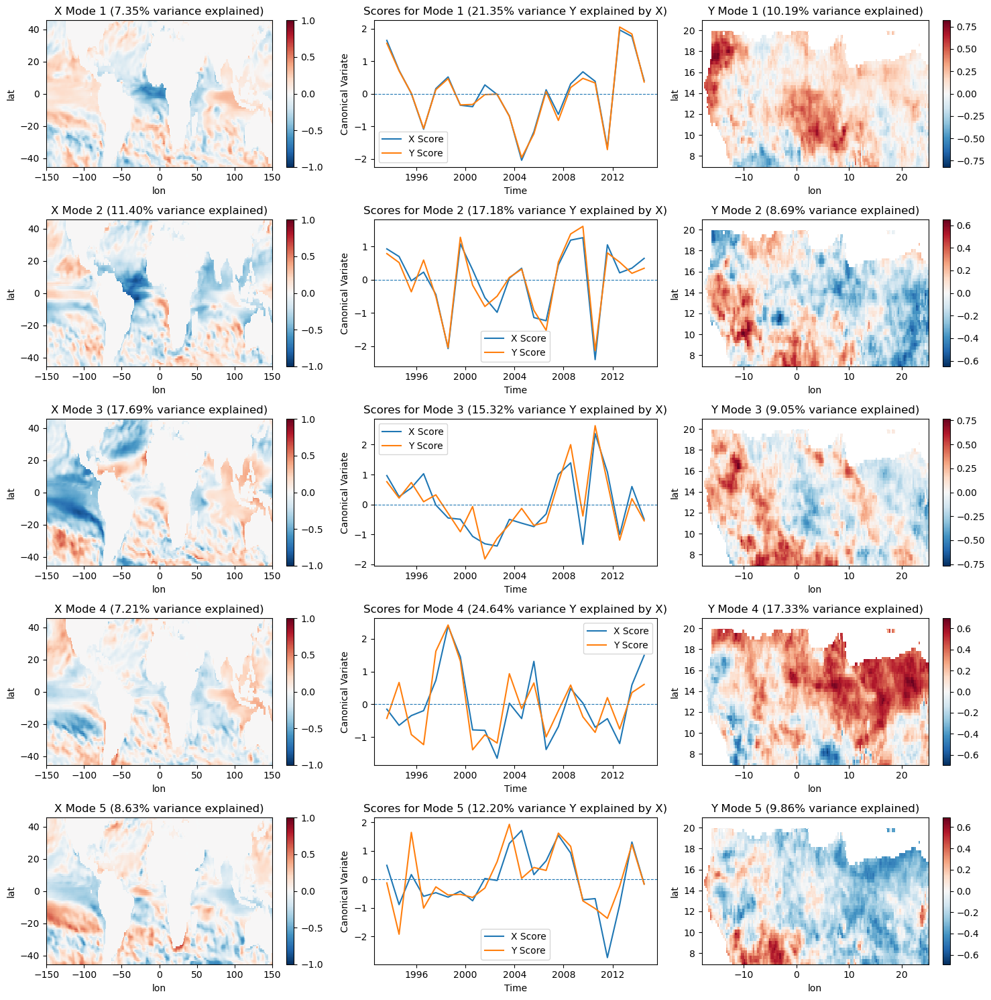

CCA Modes for model NCAR_CCSM4_1.SST


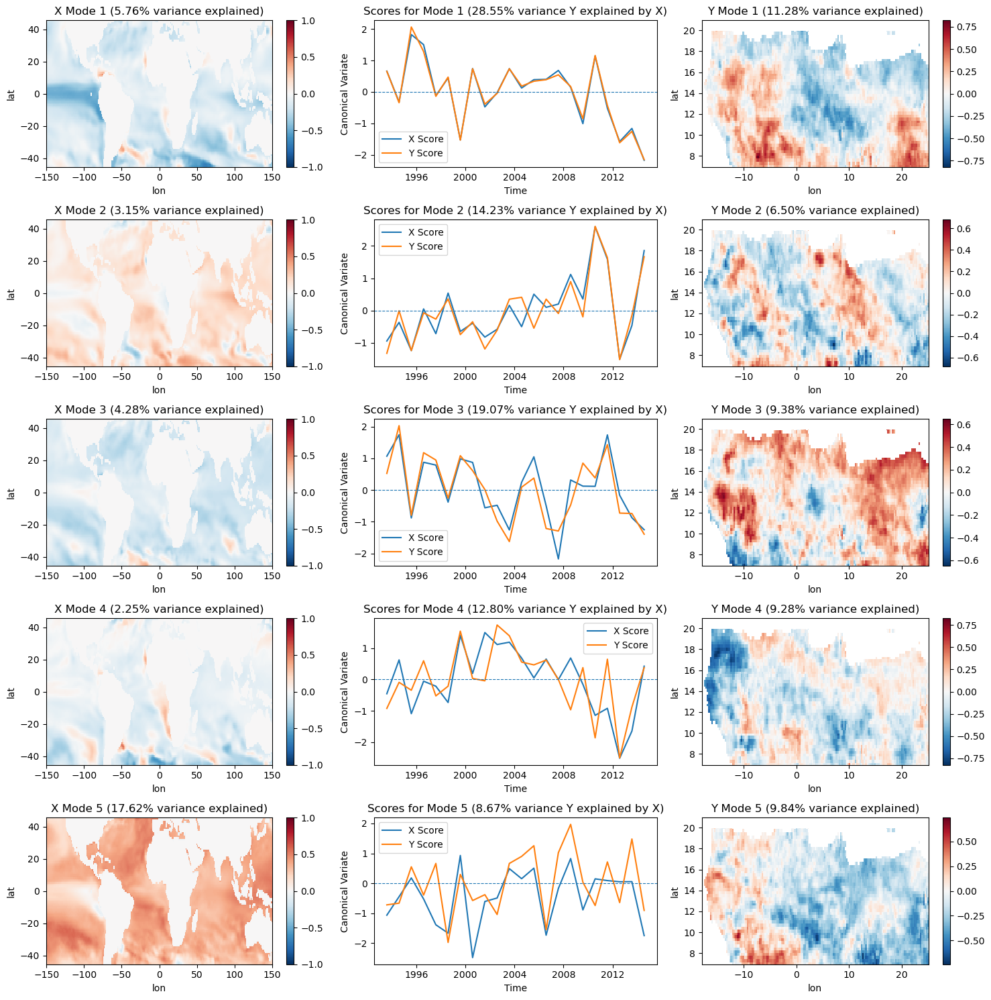

CCA Modes for model NMME_1.SST


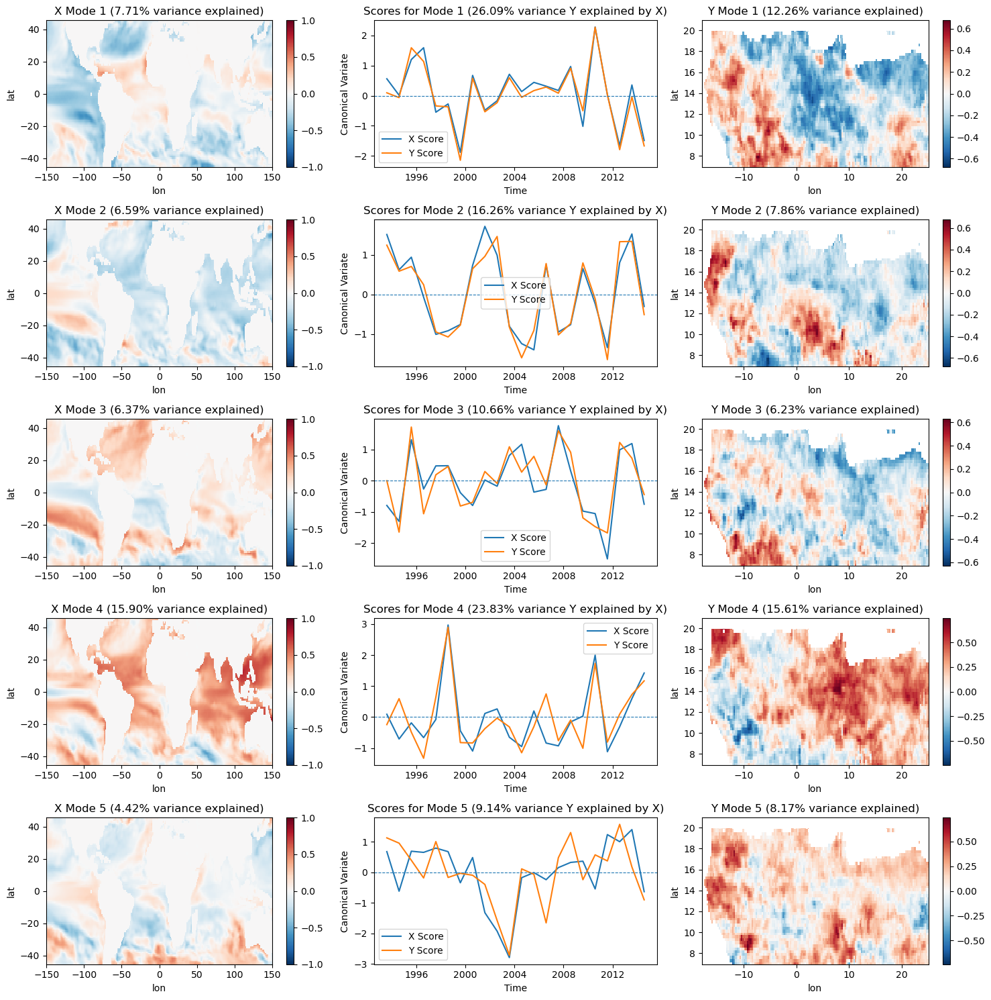

In [43]:
predictors = {}
for i in center_variable:
    predictors[i] = retrieve_single_zone_for_PCR(dir_to_save_model, defined_zone, i, year_start_model, year_end_model, clim_year_start=clim_year_start, clim_year_end=clim_year_end, model=True, month_of_initialization=month_of_initialization, lead_time=lead_time)
    predictor = predictors[i].isel(T = slice(None,-1))
    predictor['T'] = rainfall.sel(T=slice(str(year_start_model),str(year_end_model)))['T']
    print(f"CCA Modes for model {i}")
    was_cca.plot_cca_results(X=predictor, Y=rainfall.sel(T=slice(str(year_start_model),str(year_end_model))) , clim_year_start=clim_year_start, clim_year_end=clim_year_end)

#### Cross validation

In [44]:
hindcast_det_dynam_all = {}
hindcast_prob_dynam_all = {}
for key, predictor in predictors.items():
    predictor = predictor.isel(T = slice(None,-1))
    predictor['T'] = rainfall.sel(T=slice(str(year_start_model),str(year_end_model)))['T']
    print(key.split(".")[0])
    hindcast_det_dynam_all[key], hindcast_prob_dynam_all[key] = was_cv.cross_validate(was_cca, rainfall.sel(T=slice(str(year_start_model),str(year_end_model))).sel(T=slice(str(year_start_model),str(year_end_model))), predictor, clim_year_start, clim_year_end)

ECMWF_51
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.09it/s]


METEOFRANCE_8
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.08it/s]


DWD_21
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.05it/s]


CMCC_35
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.04it/s]


NCEP_2
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.01it/s]


JMA_3
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.01it/s]


ECCC_4
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.01it/s]


ECCC_5
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.06it/s]


CFSV2_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.04it/s]


CMC1_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.03it/s]


CMC2_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.04it/s]


GFDL_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:22<00:00,  1.09it/s]


NCAR_CCSM4_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.02it/s]


NMME_1
Cross-validation ongoing


100%|███████████████████████████████████████████| 24/24 [00:23<00:00,  1.03it/s]


#### Verification (individual)

###### Deterministic

In [45]:
score = ['Pearson','MAE']
model_name = "CCA_2nd_Approch"

Pearson Correlation


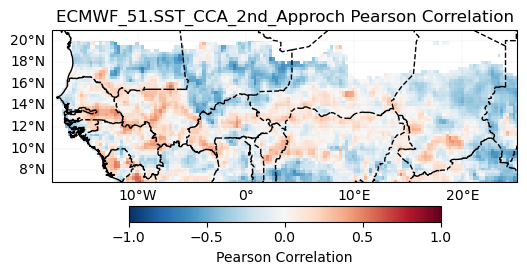

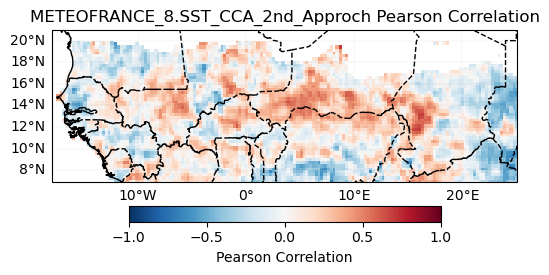

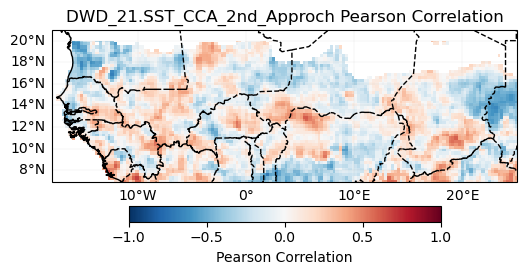

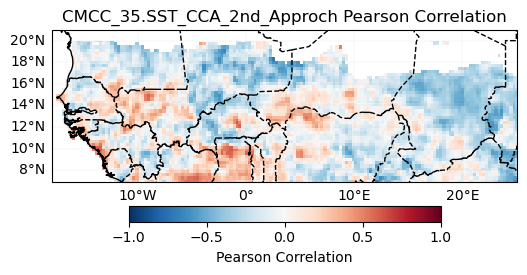

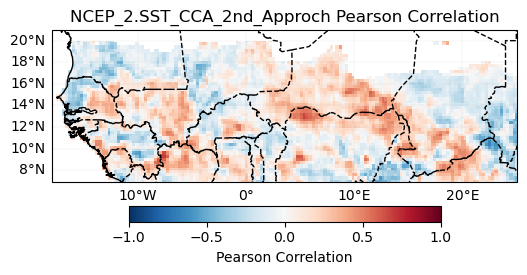

...

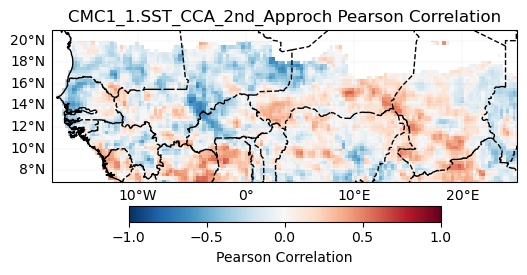

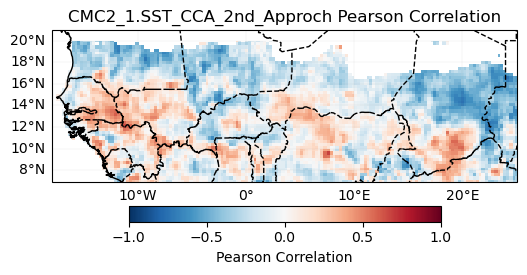

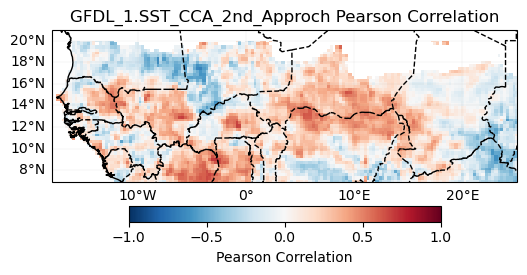

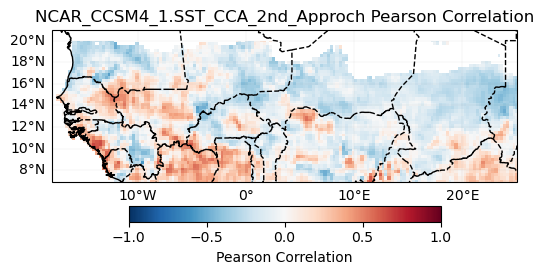

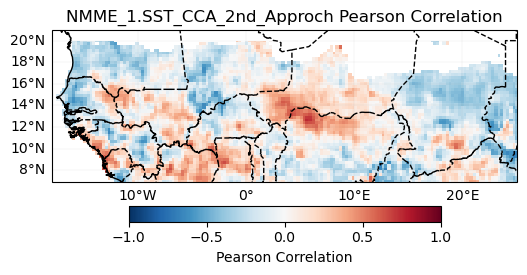

Mean Absolute Error


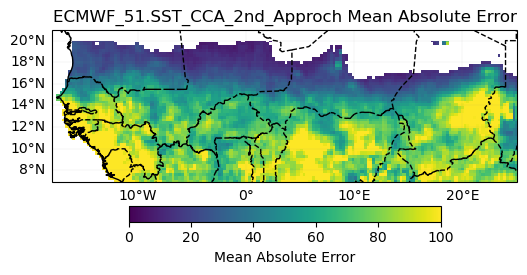

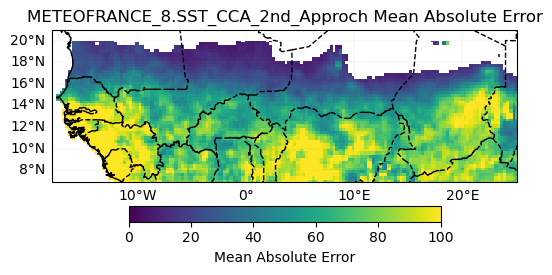

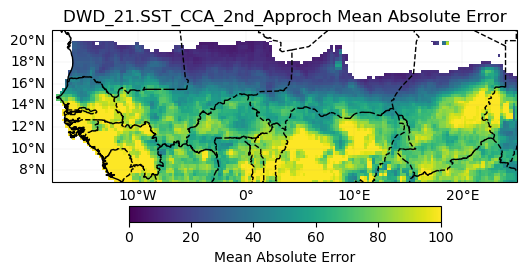

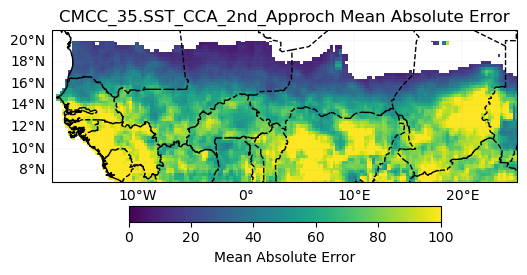

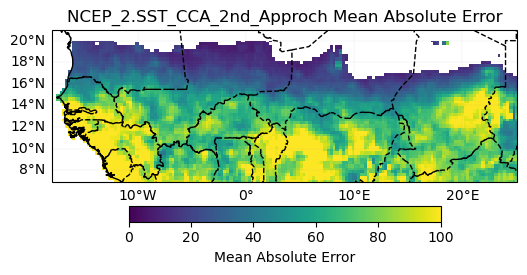

...

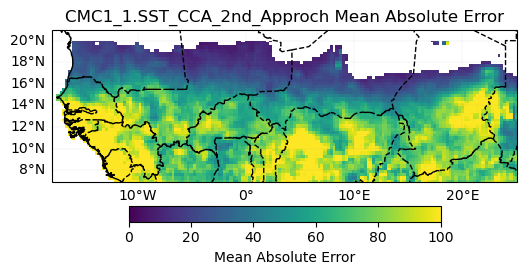

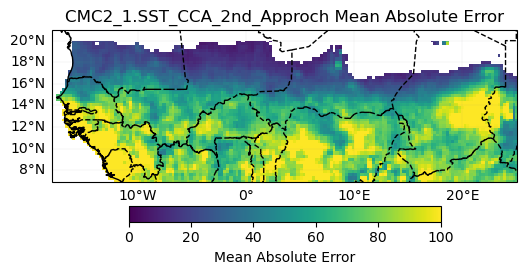

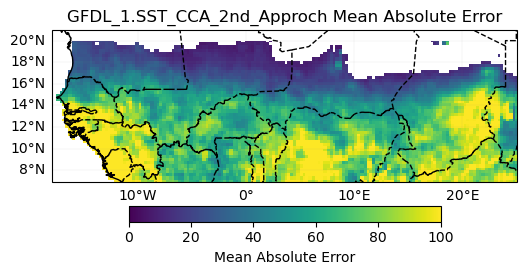

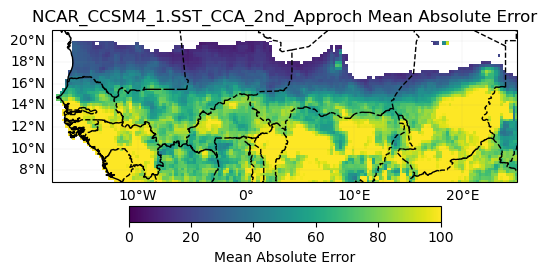

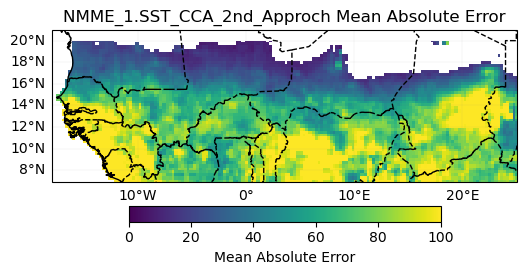

In [46]:
cca_scores = {}
tmp = {}
for i in score:
    print(was_verify.scores[i][0])
    for key, hdcst in hindcast_det_dynam_all.items():
        tmp[key] = was_verify.compute_deterministic_score(
            was_verify.get_scores_metadata()[i][5],
            rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
            hindcast_det_dynam_all[key]
        )
        was_verify.plot_model_score(tmp[key], i, dir_save_score, f"{key}_{model_name}")
    cca_scores[i] = tmp

###### Probabilistic

In [47]:
score = ['GROC']

Generalized Discrimination Score


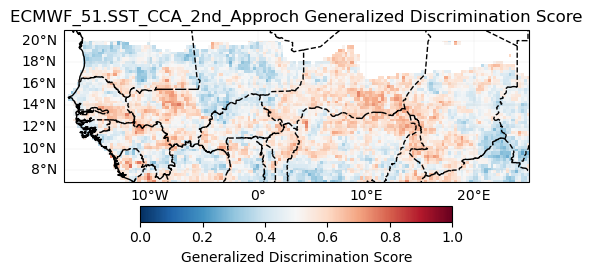

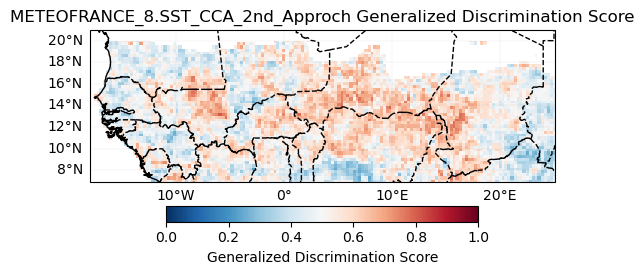

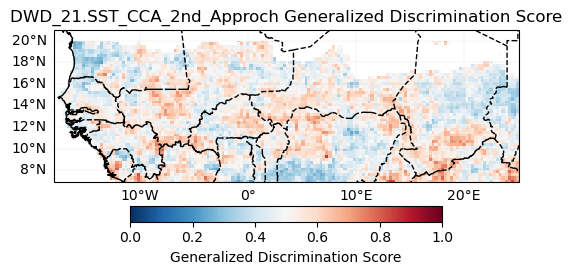

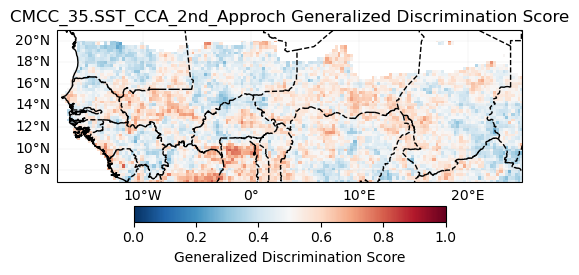

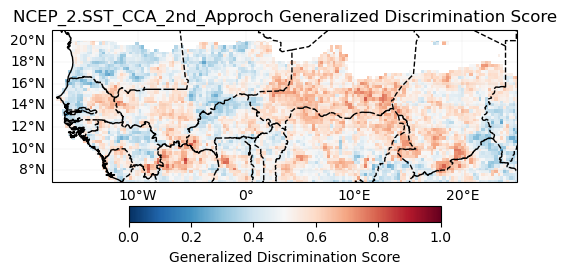

...

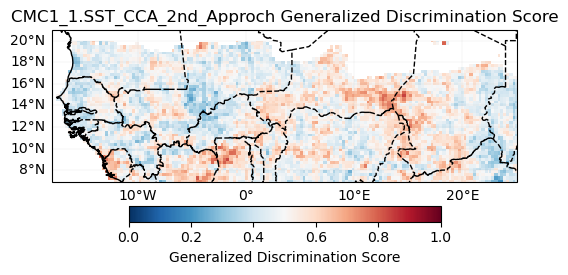

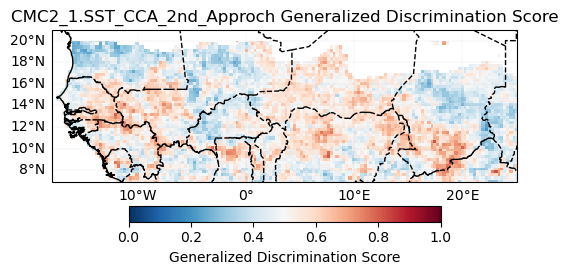

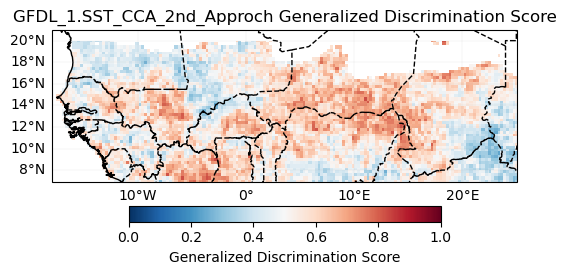

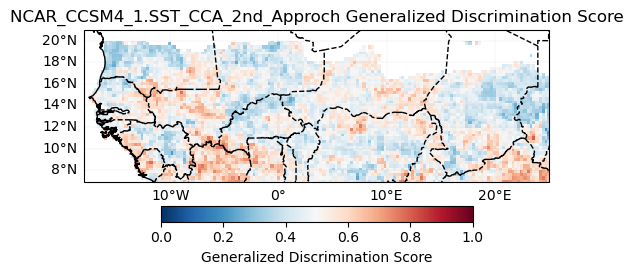

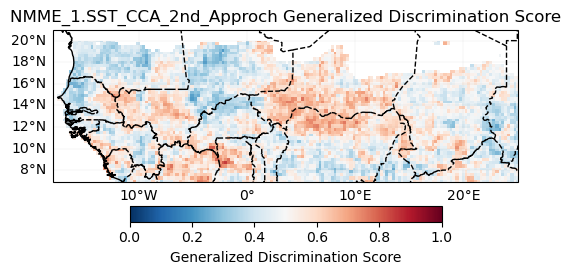

In [48]:
score = score.append('GROC') if 'GROC' not in score else score
tmp = {}
for i in score:
    print(was_verify.scores[i][0])
    for key, hdcst in hindcast_det_dynam_all.items():
        tmp[key] = was_verify.compute_probabilistic_score(
            was_verify.get_scores_metadata()[i][5],
            rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
            hindcast_prob_dynam_all[key],
            clim_year_start,
            clim_year_end)
        was_verify.plot_model_score(tmp[key], i, dir_save_score, f"{key}_{model_name}")
    cca_scores[i] = tmp

#### Forecast (individual)

ECMWF_51


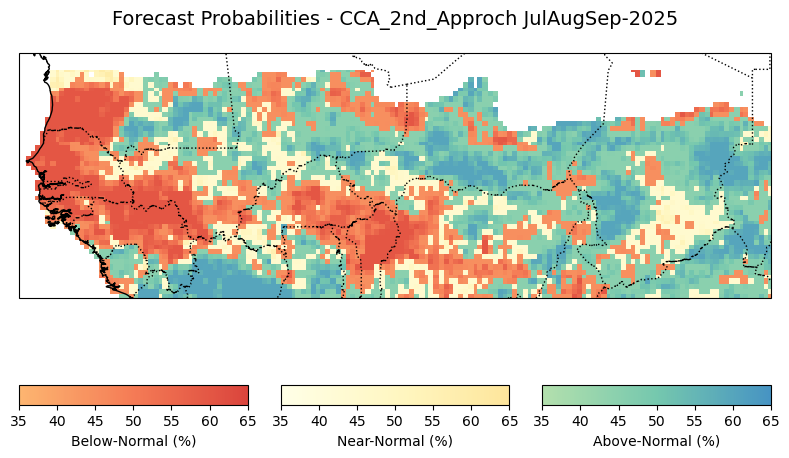

METEOFRANCE_8


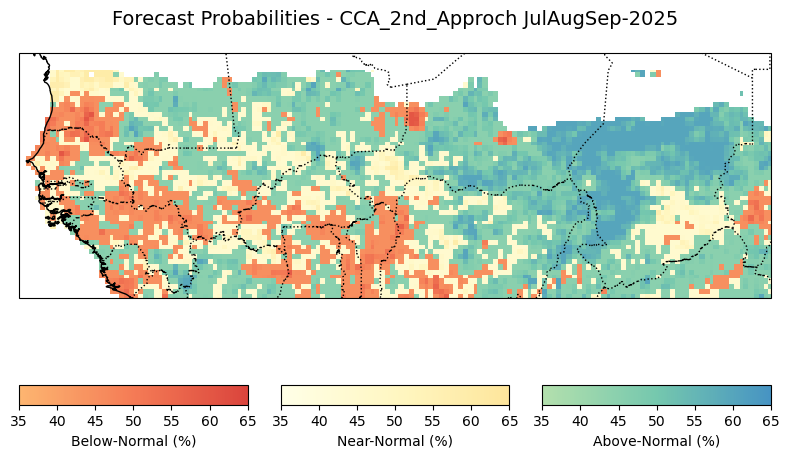

DWD_21


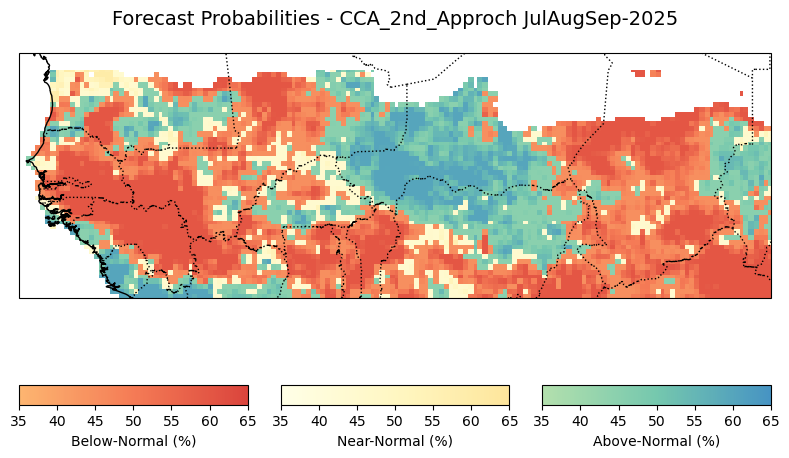

CMCC_35


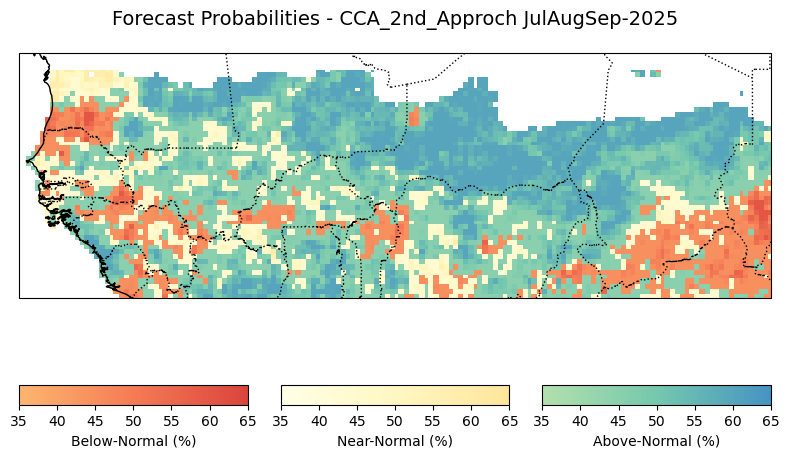

NCEP_2


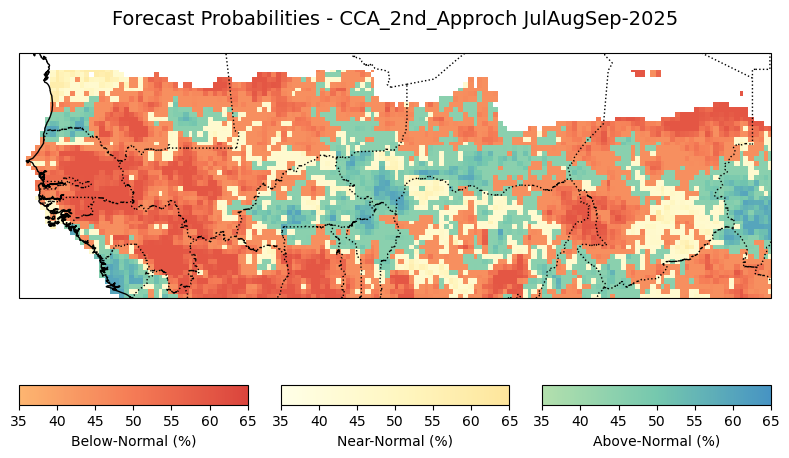

JMA_3


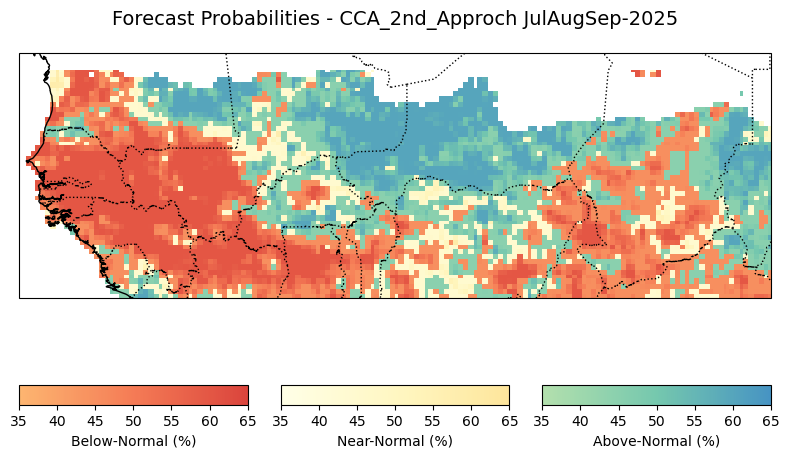

ECCC_4


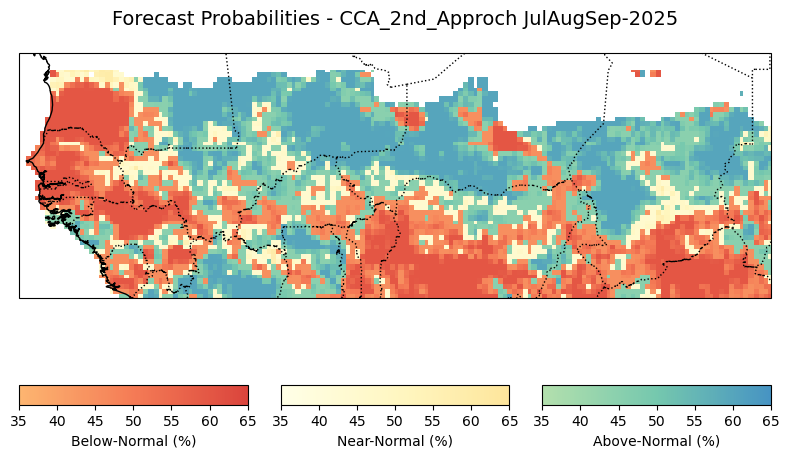

ECCC_5


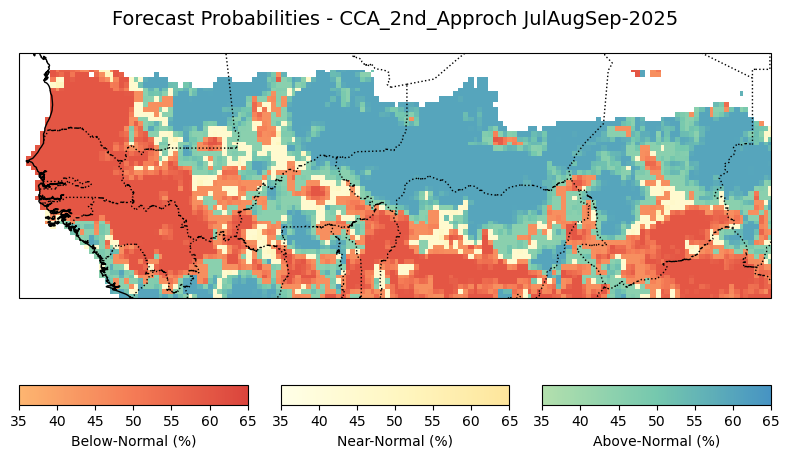

CFSV2_1


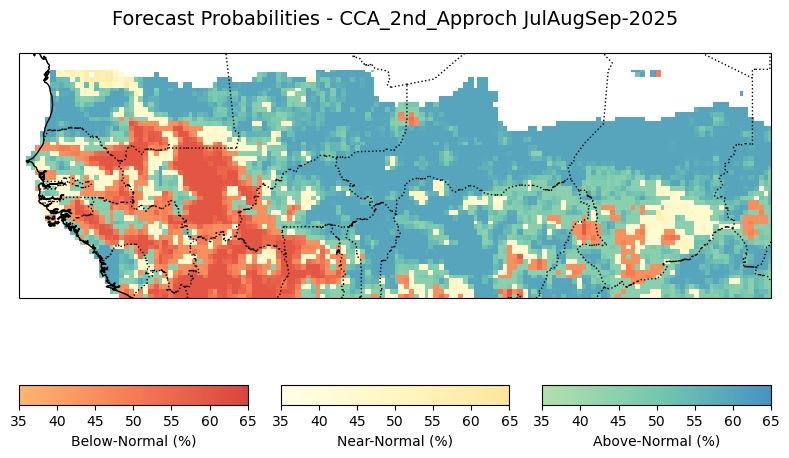

CMC1_1


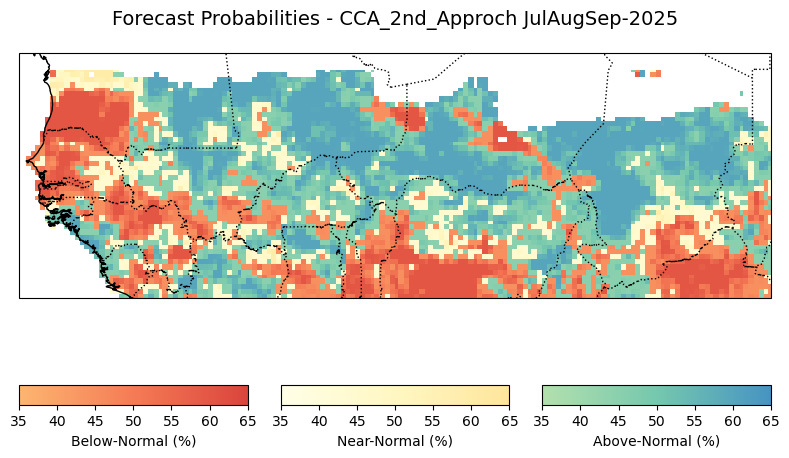

CMC2_1


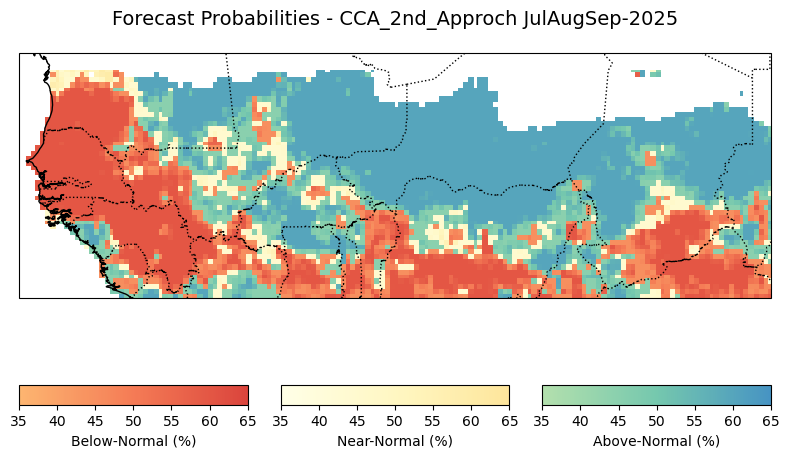

GFDL_1


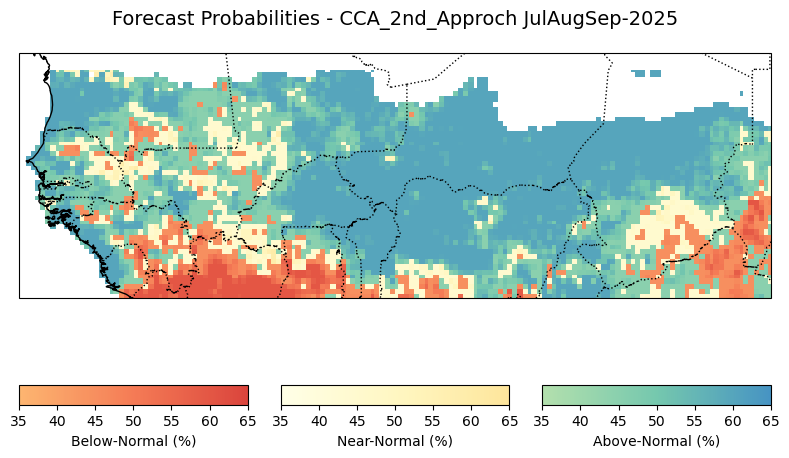

NCAR_CCSM4_1


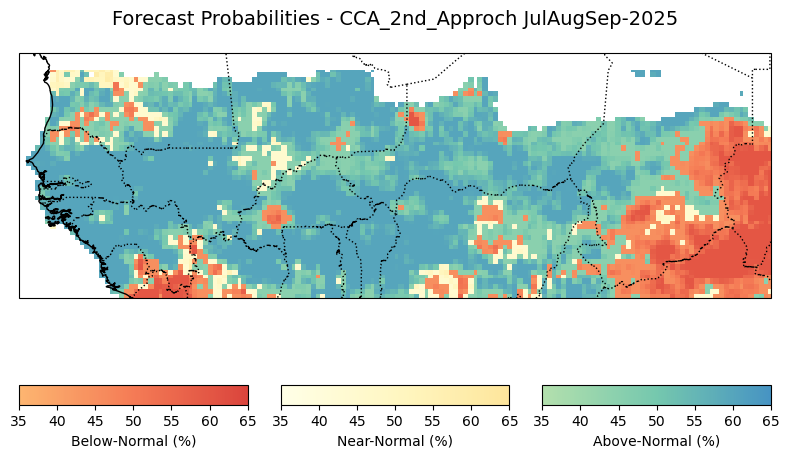

NMME_1


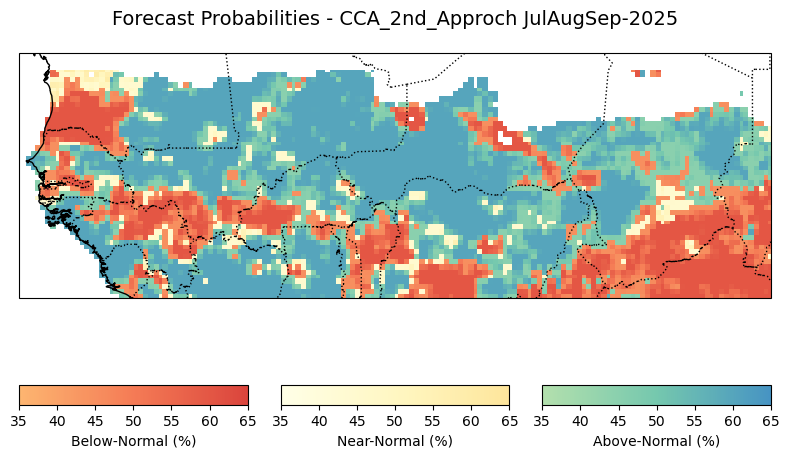

In [49]:
forecast_det_dynam_all = {}
forecast_prob_dynam_all = {}
for key, predictor in predictors.items():
    predictor_f = predictor.isel(T=[-1])
    predictor = predictor.isel(T = slice(None,-1))
    predictor['T'] = rainfall.sel(T=slice(str(year_start_model),str(year_end_model)))['T']
    print(key.split(".")[0])
    forecast_det_dynam_all[key], forecast_prob_dynam_all[key] = was_cca.forecast(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))), clim_year_start, clim_year_end, predictor, hindcast_det_dynam_all[key], predictor_f)
    plot_prob_forecasts(dir_to_forecast, forecast_prob_dynam_all[key].drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)

### MME 2nd-Approach: Statistico-Dynamical

In [134]:
#### Select some models
best_models = get_best_models(center_variable, cca_scores, metric='MAE', threshold=50, top_n=7, gcm=False)
best_models

['METEOFRANCE_8.SST',
 'GFDL_1.SST',
 'CFSV2_1.SST',
 'DWD_21.SST',
 'NCEP_2.SST',
 'JMA_3.SST',
 'ECCC_4.SST']

In [ ]:
model = WAS_mme_GA(dist_method=dist_method)
all_model_hdcst, all_model_fcst, obs, best_score = process_datasets_for_mme(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),hdcsted=hindcast_det_dynam_all, fcsted=forecast_det_dynam_all, gcm=False, ELM_ELR=False,  best_models=best_models, scores=cca_scores, model=False)
was_2nd_mme = WAS_Cross_Validator(n_splits=len(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))).get_index("T")), nb_omit=2)

In [ ]:
hindcast_det_mme_2nd, hindcast_prob_mme_2nd = was_2nd_mme.cross_validate(model, obs, all_model_hdcst, clim_year_start, clim_year_end)
hdcst_consolidated['snd.approach'] = hindcast_det_mme_2nd

#### Verification

###### Deterministic

In [137]:
score = ['Pearson','MAE']
model_name = "MME_2nd_Approach"

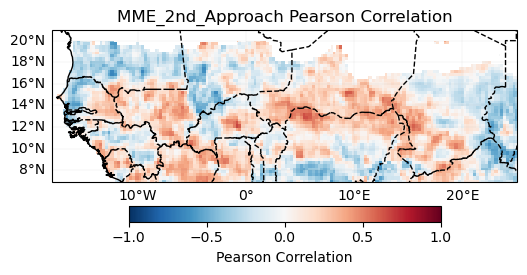

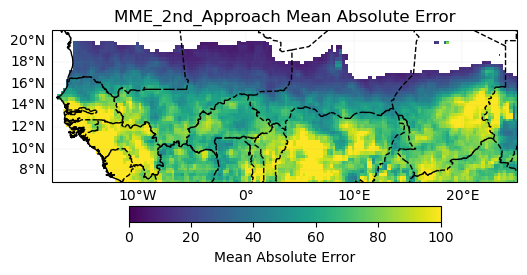

In [138]:
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
        hindcast_det_mme_2nd
    )
    # scores_consolidated[i] = {'snd.approach': r}
    scores_consolidated[i]['snd.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

###### Probabilistic

In [139]:
score = ['GROC']

Generalized Discrimination Score


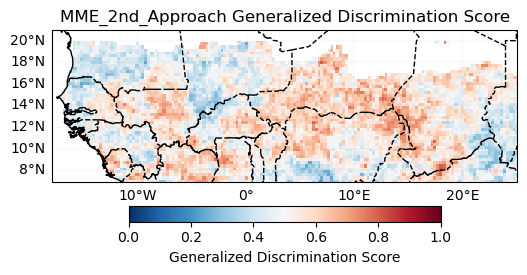

In [140]:
score = score.append('GROC') if 'GROC' not in score else score
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
        hindcast_prob_mme_2nd,
        clim_year_start,
        clim_year_end)
    scores_consolidated[i]['snd.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

#### Forecast 

In [ ]:
forecast_det_mme_2nd, forecast_prob_mme_2nd = model.forecast(obs, clim_year_start, clim_year_end, all_model_hdcst, hindcast_det_mme_2nd, all_model_fcst)
fcst_consolidated['snd.approach'] = forecast_det_mme_2nd
plot_prob_forecasts(dir_to_forecast, forecast_prob_mme_2nd.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)
gc.collect()

# 3rd - Approach: Observational-based seasonal forecast

In [58]:
# Filter model names to identify precipitation-related models
variables_reanalysis = ["ERA5.SST"] #[key for key in downloader.ReanalysisName().keys() if "SST" in key]# or "VGRD_850" in key]

# Specify the directory to save downloaded model data
dir_to_save_Reanalysis = f"{dir_s2s}/reanalysis_data/"

# choose sequence corresponding to seasonal forecast targets (JAS season in this case)
season = ["12", "01", "02"]  # July-August-September forecast period

# Define the observation period (years 1993 to 2016)
year_start = 1990
year_end = 2025

# Set the bounding box for the area of interest (latitude and longitude bounds)
extent = [60, -180, -60, 180]  # [Northern, Western, Southern and Eastern] 

# Specify whether to overwrite existing files when downloading data
force_download = False

In [59]:
downloader.WAS_Download_Reanalysis(
    dir_to_save_Reanalysis,
    variables_reanalysis,
    year_start,
    year_end,
    extent,
    season, 
    force_download
)

JAS_2025/reanalysis_data/ERA5_SST_1990_2025_DecJanFeb.nc already exists. Skipping.


##### Process SST index 

In [60]:
# Print available SST index
print(list(sst_indices_name.keys()))

['NINO34', 'NINO12', 'NINO3', 'NINO4', 'NINO_Global', 'TNA', 'TSA', 'NAT', 'SAT', 'TASI', 'WTIO', 'SETIO', 'DMI', 'MB']


In [61]:
## Choose yours
sst_index_name = ['NINO34','TNA', 'TSA', 'DMI'] 

# Set your own indices zones ( zones not available in built-in)
my_own_indices_zone = {
                         #'A': ('A', -55, 10, -20, 25),
                         # 'B': ('B', -170, -80, -10, 10),
                         # 'C': ('C', -10, 10, 1, 5),
                        }
others_zone = my_own_indices_zone

In [62]:
# Combine all zones
sst_indices_all = {i: sst_indices_name[i] for i in sst_index_name} 
sst_indices_all.update(my_own_indices_zone) if my_own_indices_zone is not None else {i: sst_indices_name[i] for i in sst_index_name} 

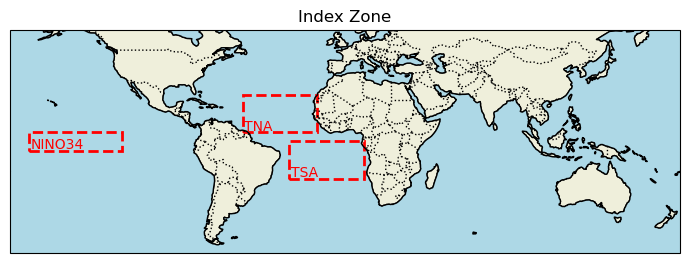

In [63]:
plot_map([extent[1],extent[3],extent[2],extent[0]], sst_indices = sst_indices_all, title="Index Zone",fig_size=(7,4))

In [64]:
predictors = compute_sst_indices(dir_to_save_Reanalysis, sst_index_name, variables_reanalysis[0], year_start, year_end, season, clim_year_start, clim_year_end, my_own_indices_zone)

ERA5 SST


##### Calculate variance inflation factor to see multicolinearity predictor

In [65]:
# Calculate VIF for each predictor
vif_data = pd.DataFrame()
vif_data["feature"] = predictors.to_dataframe().columns
vif_data["VIF"] = [VIF(predictors.to_dataframe(), i) for i in range(predictors.to_dataframe().shape[1])]
# Print VIF values
print(vif_data)

  feature       VIF
0  NINO34  1.215577
1     TNA  1.350343
2     TSA  1.716362
3     DMI  1.161171


In [66]:
# Set a threshold for VIF (e.g., 10)
vif_threshold = 5

In [67]:
low_vif_predictors = vif_data[vif_data["VIF"] < vif_threshold]["feature"].tolist()
# Filter the predictors to exclude those with high VIF
filtered_predictors = predictors[low_vif_predictors].to_array()
filtered_predictors = filtered_predictors.rename({"variable": "features"}).transpose('T', 'features')
print(low_vif_predictors)

['NINO34', 'TNA', 'TSA', 'DMI']


## Initialize WAS_LinearRegression_Model

In [68]:
# Available core over machine
cpu_count()

8

In [69]:
#### Set core number for computation
nb_cores = 4

In [70]:
# Load class for model, cross-validation and verification
model = WAS_LinearRegression_Model(nb_cores = nb_cores, dist_method=dist_method)

#### Cross validation

In [71]:
# Instantiate cross-validation
was_cv = WAS_Cross_Validator(n_splits=len(rainfall.get_index("T")), nb_omit=2)

In [72]:
filtered_predictors_ = filtered_predictors.isel(T = slice(None,-1))
filtered_predictors_['T'] = rainfall['T']
hindcast_det_obs_seas_mlr, hindcast_prob_obs_seas_mlr = was_cv.cross_validate(model, rainfall, filtered_predictors_, clim_year_start, clim_year_end)

Cross-validation ongoing


100%|███████████████████████████████████████████| 34/34 [05:03<00:00,  8.92s/it]


#### Verification

In [73]:
score = ['Pearson','MAE']
model_name = "3rd-Approach-MLR"

###### Deterministic

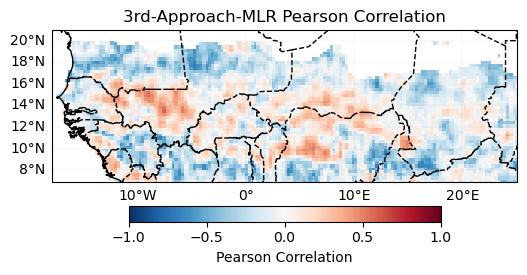

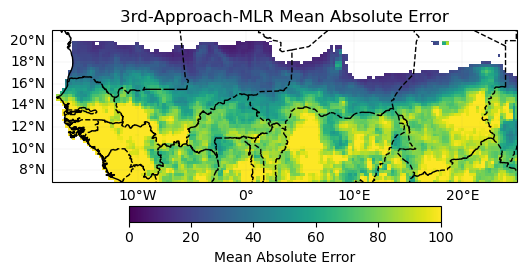

In [74]:
third_scores = {}
hindcast_det_obsBased_all = {}
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_det_obs_seas_mlr
    )
    was_verify.plot_model_score(r, i, dir_save_score, model_name)
    third_scores[i] = {'third1.score': r}
hindcast_det_obsBased_all['third1.score'] = hindcast_det_obs_seas_mlr

###### Probabilistic

In [75]:
score = ['GROC']

Generalized Discrimination Score


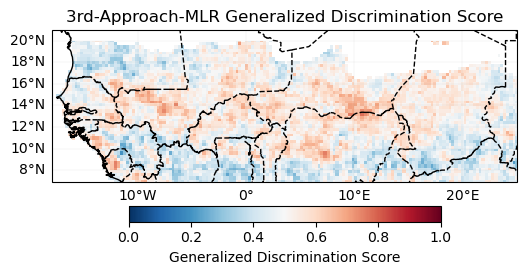

In [76]:
score = score.append('GROC') if 'GROC' not in score else score
hindcast_prob_obsBased_all = {}
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_prob_obs_seas_mlr,
        clim_year_start,
        clim_year_end)
    was_verify.plot_model_score(r, i, dir_save_score, model_name)
    third_scores[i] = {'third1.score': r}
hindcast_prob_obsBased_all['third1.score'] = hindcast_prob_obs_seas_mlr

#### Forecast

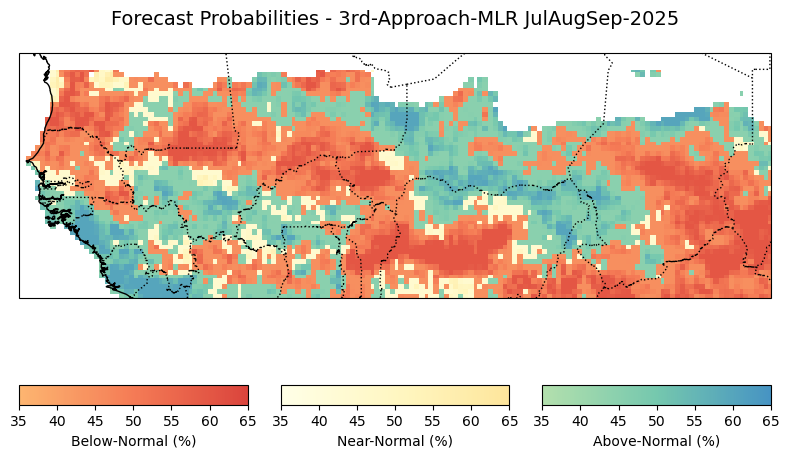

In [77]:
forecast_det_obsBased_all = {}
forecast_prob_obsBased_all = {}
f_predictors = filtered_predictors.isel(T=[-1])
f_predictors['T'] = forecast_det_gcm['T']
forecast_det_mlr, forecast_prob_mlr = model.forecast(rainfall, clim_year_start, clim_year_end, filtered_predictors_, hindcast_det_obs_seas_mlr, f_predictors)
forecast_det_obsBased_all['third1.score'] = forecast_det_mlr
forecast_prob_obsBased_all['third1.score'] = forecast_prob_mlr
plot_prob_forecasts(dir_to_forecast,forecast_prob_mlr.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)

## Initialize Principal Component Regression with ElasticNet

##### Zone for EOFs  

In [78]:
# Set your own zones ( zones not available in built-in)
# define zone as dict : {'zone_name_key': ('Explicit_Zone_name', lon_min, lon_max, lat_min, lat_max)} 
zones_for_PCR = {'A': ('A', -150, 150, -45, 45)}

# Set number of modes
n_modes=6

# ElasticNet hyperparameters range
alpha_range = np.logspace(-4, 0.1, 20)
l1_ratio_range = [0.8, 0.99, 0.9999]

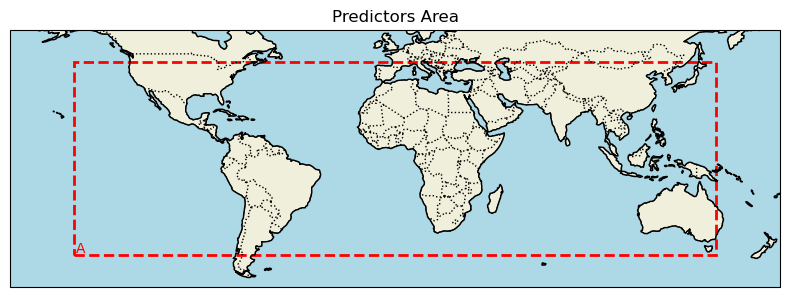

In [79]:
plot_map([extent[1],extent[3],extent[2],extent[0]], sst_indices = zones_for_PCR, title="Predictors Area",fig_size=(8,6))

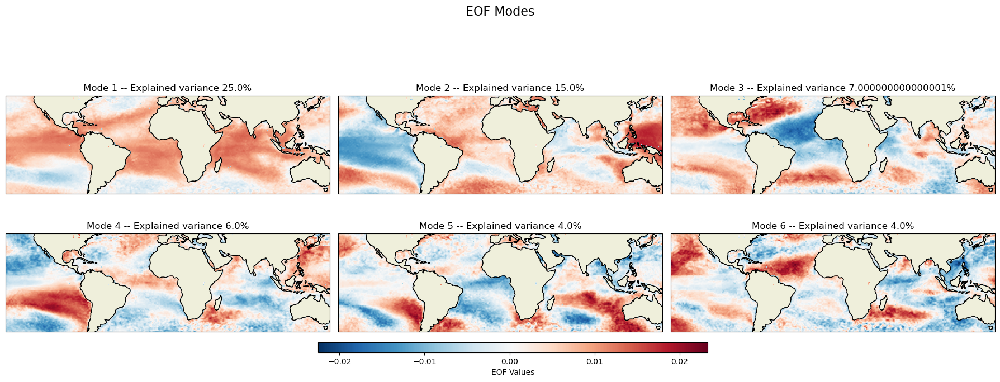

46216

In [80]:
predictor = retrieve_single_zone_for_PCR(dir_to_save_Reanalysis, zones_for_PCR, variables_reanalysis[0], year_start, year_end, season, clim_year_start, clim_year_end)
# Load WAS_EOF Class, try in a cell WAS_EOF? to see all docstring about its methods
eof_model = WAS_EOF(n_modes=n_modes, use_coslat=True, standardize=True)
# Load predictor, compute EOFs and retrieve component, scores and explained variances
s_eofs, s_pcs, s_expvar, _ = eof_model.fit(predictor, dim="T",  clim_year_start=clim_year_start, clim_year_end=clim_year_end)
eof_model.plot_EOF(s_eofs, s_expvar)
gc.collect()

#### Cross-validation

In [81]:
## Load class for model
regression_model = WAS_ElasticNet_Model(alpha_range = alpha_range, l1_ratio_range = l1_ratio_range, nb_cores = nb_cores, dist_method=dist_method)  # Initialize a linear model
pcr_model = WAS_PCR(regression_model=regression_model, n_modes=n_modes, standardize=False)

In [82]:
# Compute alpha parameters
alpha, l1_ratio, clusters = regression_model.compute_hyperparameters(rainfall, s_pcs.isel(T=slice(None,-1)).rename({"mode": "features"}).transpose('T', 'features'))

In [83]:
## Load class cross-validation
was_cv = WAS_Cross_Validator(n_splits=len(rainfall.get_index("T")), nb_omit=2)

In [84]:
hindcast_det_ElasticNet, hindcast_prob_ElasticNet = was_cv.cross_validate(pcr_model, rainfall, predictor.isel(T=slice(None,-1)), clim_year_start, clim_year_end, alpha=alpha, l1_ratio=l1_ratio)

Cross-validation ongoing


2025-03-29 11:36:30,144 - distributed.worker - ERROR - Failed to communicate with scheduler during heartbeat.
Traceback (most recent call last):
  File "/home/user/micromamba/envs/xesmf_env/lib/python3.12/site-packages/distributed/comm/tcp.py", line 225, in read
    frames_nosplit_nbytes_bin = await stream.read_bytes(fmt_size)
                                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
tornado.iostream.StreamClosedError: Stream is closed

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/home/user/micromamba/envs/xesmf_env/lib/python3.12/site-packages/distributed/worker.py", line 1251, in heartbeat
    response = await retry_operation(
               ^^^^^^^^^^^^^^^^^^^^^^
  File "/home/user/micromamba/envs/xesmf_env/lib/python3.12/site-packages/distributed/utils_comm.py", line 459, in retry_operation
    return await retry(
           ^^^^^^^^^^^^
  File "/home/user/micromamba/envs/xesmf_env/lib/python3.12/site-pack

#### Verification

###### Deterministic

In [85]:
score = ['Pearson','MAE']
model_name = "PCR with ElasticNet"

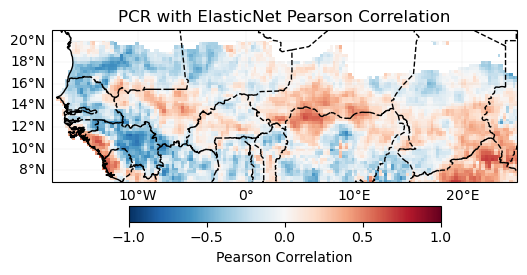

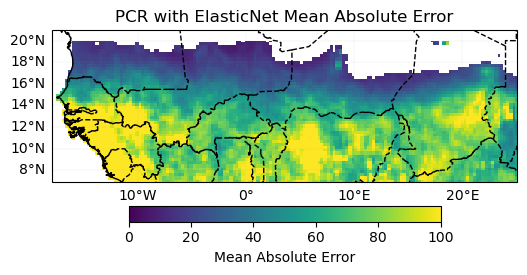

In [86]:
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_det_ElasticNet
    )
    was_verify.plot_model_score(r, i, dir_save_score, model_name)
    third_scores[i]['third2.score'] = r
hindcast_det_obsBased_all['third2.score'] = hindcast_det_ElasticNet

###### Probabilistic

In [87]:
score = ['GROC']

Generalized Discrimination Score


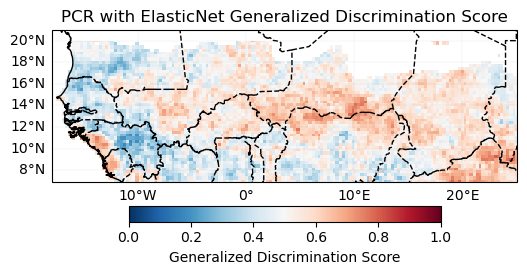

In [89]:
score = score.append('GROC') if 'GROC' not in score else score
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_prob_ElasticNet,
        clim_year_start,
        clim_year_end)
    was_verify.plot_model_score(r, i, dir_save_score, model_name)
    third_scores[i]['third2.score'] = r
hindcast_prob_obsBased_all['third2.score'] = hindcast_prob_ElasticNet

#### Forecast

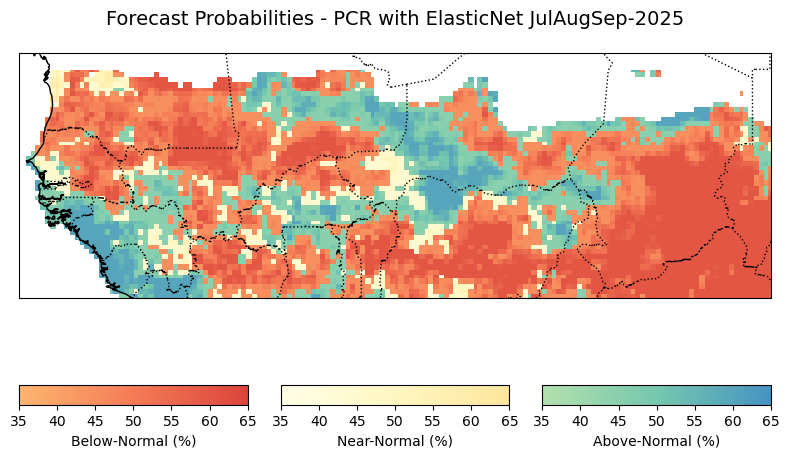

In [90]:
f_predictors = predictor.isel(T=[-1])
f_predictors['T'] = forecast_det_gcm['T']
forecast_det_ElasticNet, forecast_prob_ElasticNet = pcr_model.forecast(rainfall, clim_year_start, clim_year_end, predictor.isel(T=slice(None,-1)), hindcast_det_ElasticNet, f_predictors, alpha=alpha, l1_ratio=l1_ratio)       
forecast_det_obsBased_all['third2.score'] = forecast_det_ElasticNet
forecast_prob_obsBased_all['third2.score'] = forecast_prob_ElasticNet
plot_prob_forecasts(dir_to_forecast, forecast_prob_ElasticNet.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)

### MME Third-Approach: Observational-based seasonal forecast

In [ ]:
# set draws and chains for monte carlo simulation
draws=1000 
tune=2000
chains=4

In [91]:
#### Select some models
best_models = get_best_models(['third1.score','third2.score'], third_scores, metric='MAE', threshold=50, top_n=2, gcm=False)
best_models

['third2.score', 'third1.score']

In [92]:
all_model_hdcst, all_model_fcst, obs, best_score = process_datasets_for_mme(rainfall, hdcsted=hindcast_det_obsBased_all, fcsted=forecast_det_obsBased_all, gcm=False, ELM_ELR=False,  best_models=best_models, scores=third_scores, model=False)

In [93]:
was_3rd_mme = WAS_mme_BMA(obs, all_model_hdcst, all_model_fcst, dist_method=dist_method, alpha_=0.5, error_metric_="mae")
hindcast_det_mme_3rd  = was_3rd_mme.compute(draws=draws, tune=tune, chains=chains, verbose=False)
hindcast_prob_mme_3rd = was_3rd_mme.compute_prob(rainfall, clim_year_start, clim_year_end, hindcast_det_mme_3rd)
hdcst_consolidated['third.approach'] = hindcast_det_mme_3rd.sel(T=slice(str(year_start_model),str(year_end_model)))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [offset, scale, sigma]
Sampling 2 chains for 1_000 tune and 500 draw iterations (2_000 + 1_000 draws total) took 273 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [offset, scale, sigma]
Sampling 2 chains for 1_000 tune and 500 draw iterations (2_000 + 1_000 draws total) took 346 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


#### Verification

###### Deterministic

In [94]:
score = ['Pearson','MAE']
model_name = "MME_3rd_Approach"

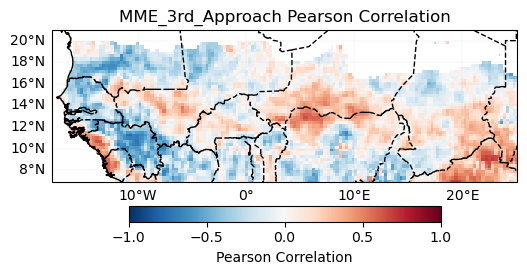

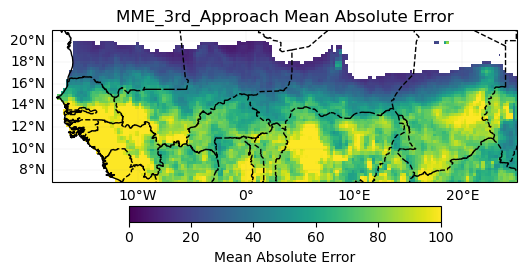

In [95]:
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_det_mme_3rd
    )
    scores_consolidated[i]['third.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

###### Probabilistic

In [96]:
score = ['GROC']

Generalized Discrimination Score


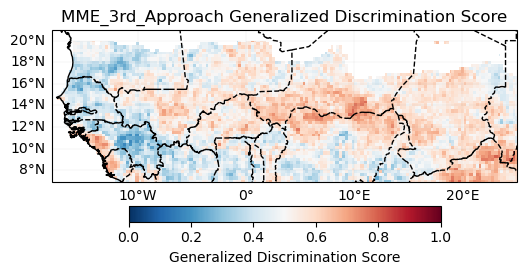

In [97]:
score = score.append('GROC') if 'GROC' not in score else score
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_prob_mme_3rd,
        clim_year_start,
        clim_year_end)
    scores_consolidated[i]['third.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

#### Forecast

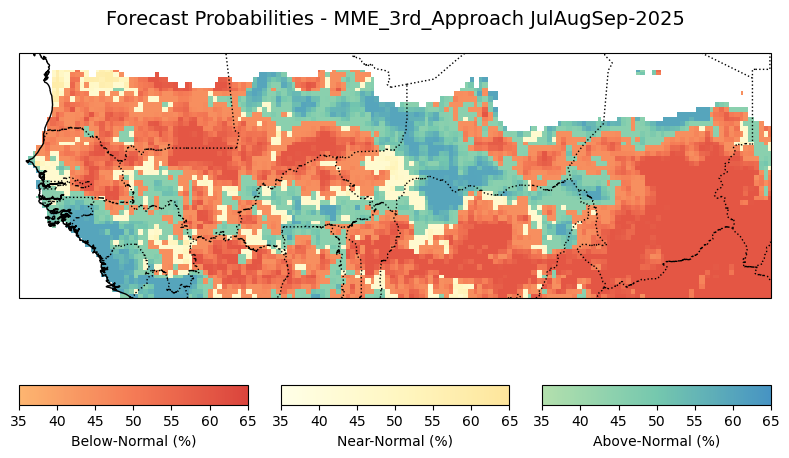

55095

In [98]:
forecast_det_mme_3rd, forecast_prob_mme_3rd = was_3rd_mme.forecast(obs, clim_year_start, clim_year_end, hindcast_det_mme_3rd)
fcst_consolidated['third.approach'] = forecast_det_mme_3rd
plot_prob_forecasts(dir_to_forecast, forecast_prob_mme_3rd.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)
gc.collect()

# 4th - Analog-based seasonal forecast

## Initialize WAS_Analog class

In [99]:
## Load class for model, cross-validation and verification
model = WAS_Analog(f"{dir_s2s}/analog", 
                    1990, 2025,"NOAA.SST", "NCEP_2.SST",
                    method_analog ="som", 
                    month_of_initialization=2,
                    clim_year_start=clim_year_start, 
                    clim_year_end=clim_year_end,
                    # define_extent = None,
                    index_compute = ['NINO34', 'NINO12', 'NINO3', 'NINO4', 'NINO_Global', 'TNA', 'TSA',  'WTIO', 'SETIO', 'MB','TASI', 'DMI','M1','M2','M3','M4'],
                    some_grid_size = (3, 3),
                    some_learning_rate=0.1,
                    some_neighborhood_function='gaussian',
                    some_sigma=1,
                    dist_method=dist_method
                    )

#### Cross-validation

In [100]:
was_analog_cv = WAS_Cross_Validator(n_splits=len(rainfall.get_index("T")), nb_omit=2)

In [101]:
hindcast_analog_det, hindcast_analog_prob = was_analog_cv.cross_validate(model, rainfall, clim_year_start=clim_year_start, clim_year_end=clim_year_end)
hdcst_consolidated['fourth.approach'] = hindcast_analog_det.sel(T=slice(str(year_start_model),str(year_end_model)))

JAS_2025/analog/NOAA_SST_1990_2025_JanFebMarAprMayJunJulAugSepOctNovDec.nc already exists. Skipping download.
Lead time not provided. Using months: [1, 2, 3, 4, 5] with Feb as initialization month
JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc
File 'JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc' already exists. Skipping download.
All requested SST data has been processed.
Cross-validation ongoing


  3%|█▎                                          | 1/34 [00:00<00:11,  2.92it/s]

similar years for 1991 are [1994 2009]


  6%|██▌                                         | 2/34 [00:00<00:09,  3.28it/s]

similar years for 1992 are [2010]


  9%|███▉                                        | 3/34 [00:00<00:09,  3.39it/s]

similar years for 1993 are [1991 1992]


 12%|█████▏                                      | 4/34 [00:01<00:08,  3.45it/s]

similar years for 1994 are [1991 1993]


 15%|██████▍                                     | 5/34 [00:01<00:08,  3.46it/s]

similar years for 1995 are [1992 2003]


 18%|███████▊                                    | 6/34 [00:01<00:08,  3.47it/s]

similar years for 1996 are [1999 2000 2001 2006 2008 2011 2012]


 21%|█████████                                   | 7/34 [00:02<00:07,  3.49it/s]

similar years for 1997 are [1996 2002 2006]


 24%|██████████▎                                 | 8/34 [00:02<00:07,  3.51it/s]

similar years for 1998 are [2016 2024]


 26%|███████████▋                                | 9/34 [00:02<00:07,  3.52it/s]

similar years for 1999 are [1996 2006 2008 2009 2011 2012]


 29%|████████████▋                              | 10/34 [00:02<00:06,  3.52it/s]

similar years for 2000 are [1996 1999 2006 2008 2009 2011 2012]


 32%|█████████████▉                             | 11/34 [00:03<00:06,  3.53it/s]

similar years for 2001 are [1996 1999 2000 2008]


 35%|███████████████▏                           | 12/34 [00:03<00:06,  3.54it/s]

similar years for 2002 are [1997 2006 2012]


 38%|████████████████▍                          | 13/34 [00:03<00:05,  3.55it/s]

similar years for 2003 are [1995 2007 2010]


 41%|█████████████████▋                         | 14/34 [00:04<00:05,  3.53it/s]

similar years for 2004 are [2009 2013]


 44%|██████████████████▉                        | 15/34 [00:04<00:05,  3.54it/s]

similar years for 2005 are [2003 2010]


 47%|████████████████████▏                      | 16/34 [00:04<00:05,  3.55it/s]

similar years for 2006 are [1996 1999 2000 2001 2009 2012]


 50%|█████████████████████▌                     | 17/34 [00:04<00:04,  3.53it/s]

similar years for 2007 are [1995 2003 2004 2005 2013]


 53%|██████████████████████▊                    | 18/34 [00:05<00:04,  3.53it/s]

similar years for 2008 are [1999 2000 2012]


 56%|████████████████████████                   | 19/34 [00:05<00:04,  3.55it/s]

similar years for 2009 are [2013 2020]


 59%|█████████████████████████▎                 | 20/34 [00:05<00:03,  3.56it/s]

similar years for 2010 are [2003 2007]


 62%|██████████████████████████▌                | 21/34 [00:05<00:03,  3.56it/s]

similar years for 2011 are [2018 2021 2022]


 65%|███████████████████████████▊               | 22/34 [00:06<00:03,  3.57it/s]

similar years for 2012 are [1997 2002 2006]


 68%|█████████████████████████████              | 23/34 [00:06<00:03,  3.56it/s]

similar years for 2013 are [2004 2009 2017]


 71%|██████████████████████████████▎            | 24/34 [00:06<00:02,  3.55it/s]

similar years for 2014 are [2018 2021 2022 2023]


 74%|███████████████████████████████▌           | 25/34 [00:07<00:02,  3.55it/s]

similar years for 2015 are [2019 2020]


 76%|████████████████████████████████▉          | 26/34 [00:07<00:02,  3.55it/s]

similar years for 2016 are [1998 2024]


 79%|██████████████████████████████████▏        | 27/34 [00:07<00:01,  3.55it/s]

similar years for 2017 are [2014 2023]


 82%|███████████████████████████████████▍       | 28/34 [00:07<00:01,  3.54it/s]

similar years for 2018 are [2011 2021 2022]


 85%|████████████████████████████████████▋      | 29/34 [00:08<00:01,  3.56it/s]

similar years for 2019 are [2015]


 88%|█████████████████████████████████████▉     | 30/34 [00:08<00:01,  3.55it/s]

similar years for 2020 are [2015 2019]


 91%|███████████████████████████████████████▏   | 31/34 [00:08<00:00,  3.55it/s]

similar years for 2021 are [1999 2000 2008 2011 2018]


 94%|████████████████████████████████████████▍  | 32/34 [00:09<00:00,  3.52it/s]

similar years for 2022 are [1999 2000 2008 2011 2018 2021]


 97%|█████████████████████████████████████████▋ | 33/34 [00:09<00:00,  3.54it/s]

similar years for 2023 are [2014 2017]


100%|███████████████████████████████████████████| 34/34 [00:09<00:00,  3.52it/s]

similar years for 2024 are [1998 2016]


#### Verification

###### Deterministic

In [102]:
score = ['Pearson','MAE']
model_name = "analog_method"

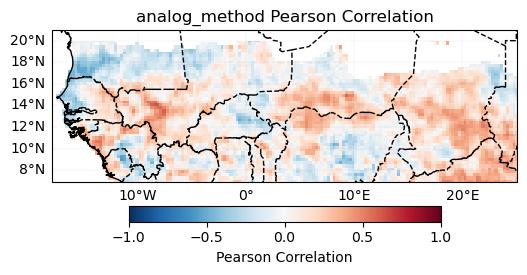

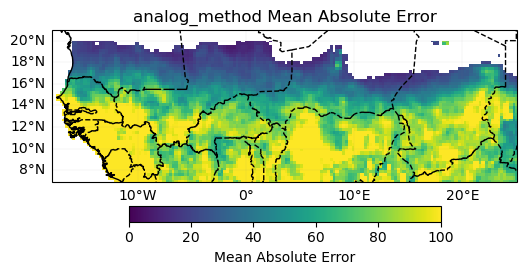

In [103]:
for i in score:
    r = was_verify.compute_deterministic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_analog_det
    )
    scores_consolidated[i]['fourth.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

###### Probabilistic

In [104]:
score = ['GROC']

Generalized Discrimination Score


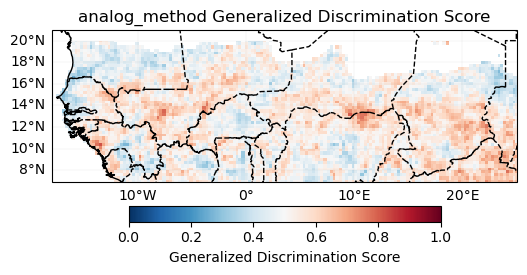

In [105]:
score = score.append('GROC') if 'GROC' not in score else score
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall,
        hindcast_analog_prob,
        clim_year_start,
        clim_year_end)
    scores_consolidated[i]['fourth.approach'] = r
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

#### Forecast

JAS_2025/analog/NOAA_SST_1990_2025_JanFebMarAprMayJunJulAugSepOctNovDec.nc already exists. Skipping download.
Lead time not provided. Using months: [1, 2, 3, 4, 5] with Feb as initialization month
JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc
File 'JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc' already exists. Skipping download.
All requested SST data has been processed.


array([2017, 2023])

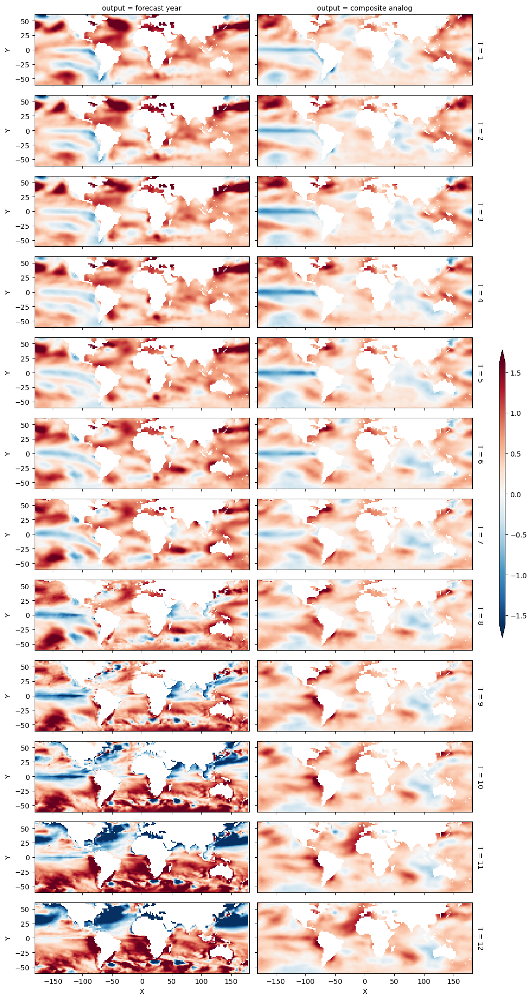

In [106]:
## Analysis SST evolution
model.composite_plot(rainfall, clim_year_start, clim_year_end, hindcast_analog_det, plot_predictor=True)

JAS_2025/analog/NOAA_SST_1990_2025_JanFebMarAprMayJunJulAugSepOctNovDec.nc already exists. Skipping download.
Lead time not provided. Using months: [1, 2, 3, 4, 5] with Feb as initialization month
JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc
File 'JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc' already exists. Skipping download.
All requested SST data has been processed.


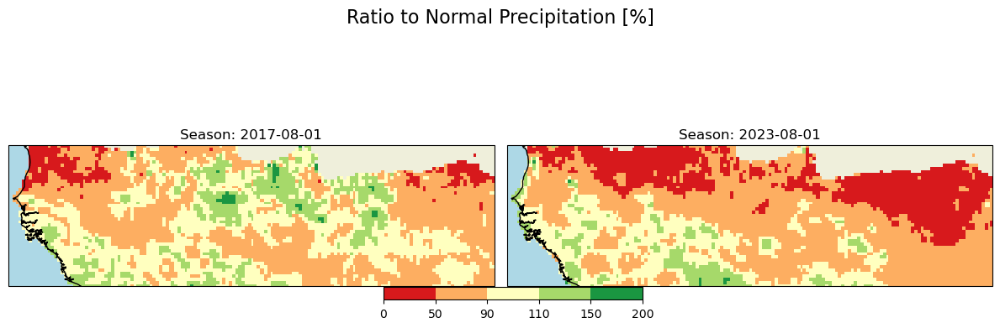

array([2017, 2023])

In [107]:
## Plot silimar years behavior
model.composite_plot(rainfall, clim_year_start, clim_year_end, hindcast_analog_det, plot_predictor=False)

JAS_2025/analog/NOAA_SST_1990_2025_JanFebMarAprMayJunJulAugSepOctNovDec.nc already exists. Skipping download.
Lead time not provided. Using months: [1, 2, 3, 4, 5] with Feb as initialization month
JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc
File 'JAS_2025/analog/forecast_ncep2_SST_FebIc_MarAprMayJunJul.nc' already exists. Skipping download.
All requested SST data has been processed.


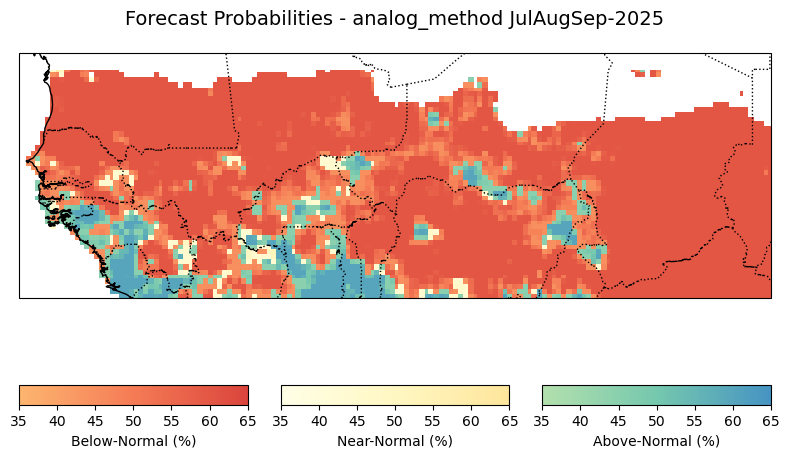

In [108]:
ddd, similar_years, forecast_det_analog, forecast_prob_analog = model.forecast(rainfall, clim_year_start, clim_year_end, hindcast_analog_det, forecast)
fcst_consolidated['fourth.approach'] = forecast_det_analog
plot_prob_forecasts(dir_to_forecast, forecast_prob_analog.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)

# Consolidated Forecasts

In [141]:
best_models = ["first.approach", 'snd.approach' ,'third.approach', 'fourth.approach']

#### Cross-validation

In [142]:
all_model_hdcst, all_model_fcst, obs, best_score = process_datasets_for_mme(rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),hdcsted=hdcst_consolidated, fcsted=fcst_consolidated, gcm=False, ELM_ELR=False, Prob=True, best_models=best_models, scores=scores_consolidated, model=False)

In [143]:
was_mme = WAS_Min2009_ProbWeighted()
hindcast_prob, forecast_prob  = was_mme.compute(obs, all_model_hdcst, all_model_fcst, best_score, threshold=0.5, complete=True)

#### Consolidated forecast Skill

##### Probabilistic

In [146]:
score = ['GROC']

Generalized Discrimination Score


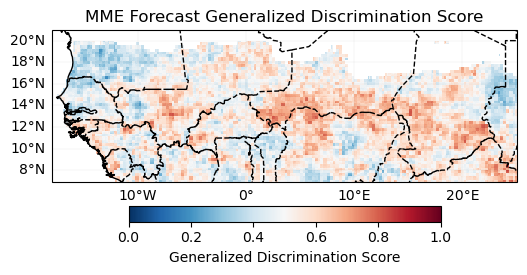

In [147]:
for i in score:
    print(was_verify.scores[i][0])
    r = was_verify.compute_probabilistic_score(
        was_verify.get_scores_metadata()[i][5],
        rainfall.sel(T=slice(str(year_start_model),str(year_end_model))),
        hindcast_prob,
        clim_year_start,
        clim_year_end) 
    was_verify.plot_model_score(r, i, dir_save_score, model_name)

##### Plot Roc curves

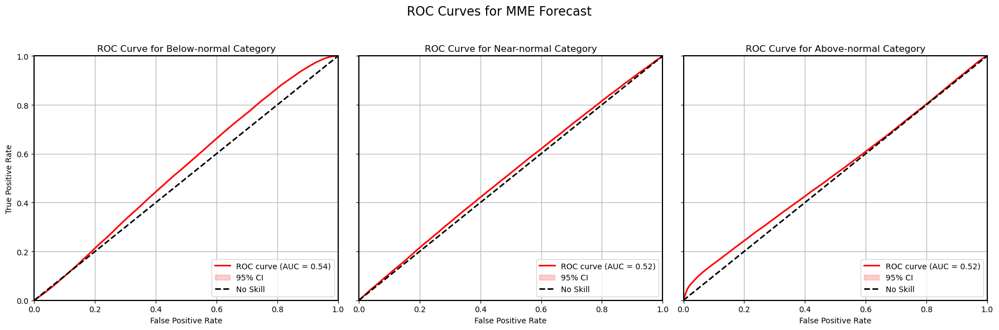

In [148]:
was_verify.plot_roc_curves(model_name, dir_save_score, rainfall.sel(T=slice(str(year_start_model),str(year_end_model))), hindcast_prob, clim_year_start, clim_year_end, n_bootstraps=100, ci=0.95)

In [ ]:
was_verify.reliability_diagram(model_name, dir_save_score, rainfall.sel(T=slice(str(year_start_model),str(year_end_model))), hindcast_det_prob, clim_year_start, clim_year_end)

### Forecast 

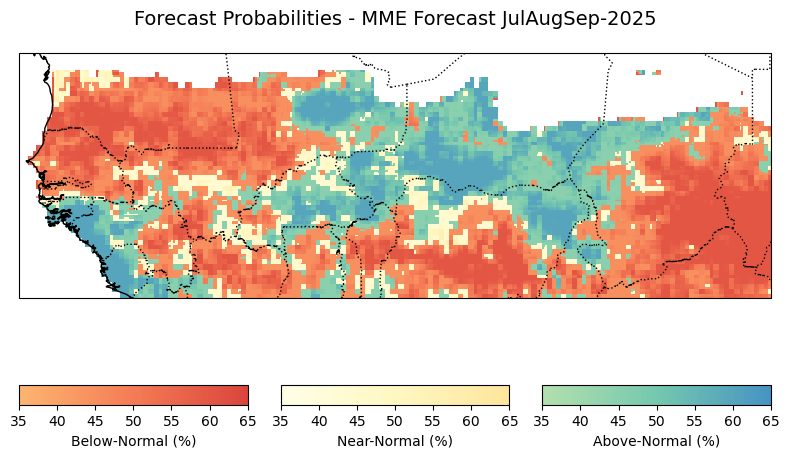

In [149]:
plot_prob_forecasts(dir_to_forecast, forecast_prob.drop_vars('T').squeeze(), f"{model_name} {season_str}-{forecast}", reverse_cmap=False)

#### Save Forecast for future evaluation

In [130]:
#forecast_det.to_netcdf(f'{dir_to_forecast}/Forecast_Det_{season_str}_{forecast}.nc')

In [131]:
forecast_prob.to_netcdf(f'{dir_to_forecast}/Forecast_Prob_{season_str}_{forecast}.nc')

###    END  -------------------------

In [121]:
!jupyter nbconvert --to html --no-input ./01_MME_JAS_2025.ipynb

[NbConvertApp] Converting notebook ./01_MME_JAS_2025.ipynb to pdf
[NbConvertApp] Support files will be in 01_MME_JAS_2025_files/
[NbConvertApp] Making directory ./01_MME_JAS_2025_files
[NbConvertApp] Writing 82509 bytes to notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', 'notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', 'notebook']
[NbConvertApp] WARNING | bibtex had problems, most likely because there were no citations
[NbConvertApp] PDF successfully created
[NbConvertApp] Writing 16682272 bytes to 01_MME_JAS_2025.pdf
